# Procesamiento de Imágenes Digitales

Visión Computacional 2020-21 <br>
Practica 1. 6 de octubre de 2020

Autor1: Alberto Miño Calero <br>
Autor2: Adrian Michelena Sanz

## Objetivos


Los objetivos de esta práctica son:
* Repasar algunos conceptos de filtrado de imágenes y programar algunas rutinas para suavizado y extracción de bordes.
* Implementar un algoritmo de segmentación de imágenes y otro de extracción de líneas mediante la transformada de Hough.

## Requerimientos

Para esta práctica es necesario disponer del siguiente software:
* Python 2.7 ó 3.X, preferiblemente el segundo
* Jupyter http://jupyter.org/.
* Los paquetes ``python-pip`` y/o ``python-pip3`` y el paquete "PyMaxFlow"
* Las librerías científicas de Python: NumPy (``python-numpy``), SciPy (``python-scipy``) y Matplotlib (``python-matplotlib``).
* El paquete ``python-pygame``
* La librería OpenCV, que puedes instalar desde el paquete ``python-opencv``.

Las versiones preferidas del entorno de trabajo puedes consultarlas en el Aula Virtual en el archivo "ConfiguracionPC2018.txt". 

El material necesario para la práctica se puede descargar del Aula Virtual.

## Condiciones

* La fecha límite de entrega será el lunes 26 de octubre a las 23:55.
* La entrega consiste en dos archivos con el código, resultados y respuestas a los ejercicios:
  1. Un "notebook" de Jupyter con el fuente y los resultados (ejecuta "Restart & Run all" antes de guardar)
  2. Un documento "pdf" generado a partir del fuente de Jupyter, por ejemplo usando el comando ``jupyter nbconvert --execute --to pdf notebook.ipynb``. Asegúrate de que el documento "pdf" contiene todos los resultados correctamente ejecutados (previamente ejecuta en el menú "Kernel" la opción "Restart & Run All").
* Las respuestas a los ejercicios debes introducirlas en tantas celdas de código o texto como creas necesarias, insertadas inmediatamente después de  un enuciado y antes del siguiente.
* La puntuación del ejercicio 7 es el triple que el resto.
* Las prácticas puede realizarse en parejas. Sólo es necesario que uno de los miembros del equipo entregue la práctica.

## Instala el entorno de trabajo

1. Instala el entorno de trabajo.

    ``apt install python
    apt install python-scipy
    apt install python-numpy
    apt install python-matplotlib
    apt install python-opencv
    apt install jupyter
    apt install jupyter-nbconvert``

    Para para trabajar con la versión 3.X de Python, basta sustituir la palabra "python" por "python3" en los comandos anteriores.

2. Instala el paquete PyMaxflow

   ``pip install PyMaxflow`` o ``pip3 install PyMaxflow``
   
   Si no tienes el paquete "pip" debes instalarlo: ``apt install python-pip`` o ``apt install python3-pip``
3. Instala el paquete "pygame"

    ``apt install python-pygame`` 
    
    En Python 3.X, la versión 18.04 de Ubuntu no tiene el paquete "python3-pygame" pero puedes instalarlo con la herramienta pip: ``pip install pygame``

#  Filtrado

Para realizar las convoluciones utiliza la función ``convolve`` o ``convolve1d`` de ``scipy.ndimage``.


Carga y muestra las imágenes ``escgaus.bmp`` y ``escimp5.bmp`` que están contaminadas respectivamente
con ruido de tipo gaussiano e impulsional. En los siguientes ejercicios también también puedes utilizar otras imágenes
que te parezcan interesantes.

In [8]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import scipy.ndimage

print(cv2.__version__)

4.4.0


## **Ejercicio 1.** 
Escribe una función ``masc_gaus(sigma, n)`` que construya una máscara de una dimensión de un filtro gaussiano de tamaño *n* y varianza σ. Filtra las imágenes
anteriores con filtros gaussianos bidimensionales de diferentes tamaños
de *n*, y/o σ.

En este ejercicio tenéis que implementar vosotros la función que construye la máscara. No podéis usar funciones que construyan la máscara o realicen el filtrado automáticamente.

Muestra cómo afecta este filtrado a los dos tipos de ruido que contaminan las imágenes anteriores y discute los resultados. Pinta alguna de las máscaras utilizadas.

### Función máscara gaussiana
Función masc_gaus(sigma, n) que define una máscara gaussiana de 1 dimensión con tamaño n y varianza sigma.

Hay que comentar que para la mayoría de parejas de valores se han visto diferencias con respecto al valor esperado de la suma de los valores de la máscara, que debería ser 1, aunque esta diferencia se puede considerar insignificante al ser del orden 10^(-16). 

In [4]:
def masc_gaus(sigma, n):
  # Creamos un vector centrado en 0 con igual distancia entre valores contiguos
  y = np.ogrid[-(n-1)/2:(n-1)/2 + 1]
  # Contruimos el vector máscara unidimensional con la exponencial en cada valor
  masc = np.exp(-( y**2 / (2*sigma**2)))
  # Normalizamos los valores para aproximar a la gaussiana con area bajo la curva = 1
  masc = masc / masc.sum()
  return masc

Algunas pruebas para comprobar la función con las máscaras que devuelve, si están normalizadas correctamente y su producto exterior (para construir la máscara bidimensional)

Con determinado valores se has visto diferencias con respecto al valor esperado de la suma, aunque son de un orden despreciable $10^{-16}$.

In [3]:
aux1 = masc_gaus(2,10) 
aux2 = masc_gaus(3,15) 
print("masc_gaus(2,10) ",aux1, ":: suma de los valores =", aux1.sum())
print("-------")
print("masc_gaus(2,15) ",aux2, ":: suma de los valores =", aux2.sum())
print("-------")
aux3 = np.outer(aux1,aux1)
print("Suma de valores del filtro bidimensional =",aux3.sum())

masc_gaus(2,10)  [0.01605491 0.04364178 0.09238965 0.15232478 0.19558888 0.19558888
 0.15232478 0.09238965 0.04364178 0.01605491] :: suma de los valores = 1.0000000000000002
-------
masc_gaus(2,15)  [0.00884695 0.01821591 0.0335624  0.05533504 0.08163802 0.10777793
 0.12732458 0.13459835 0.12732458 0.10777793 0.08163802 0.05533504
 0.0335624  0.01821591 0.00884695] :: suma de los valores = 1.0000000000000004
-------
Suma de valores del filtro bidimensional = 1.0


### Aplicación del filtro y ejemplo para una pareja de parámetros sigma, n
Bloque que efectúa el filtrado. Se utiliza la máscara unidimensional gaussiana construida

Utilizamos convolve1d aplicando nuestra máscara tanto en el eje vertical como en el horizontal para hacer nuestro filtrado gaussiano de paso bajo y suavizar la imagen. También podría construirse el kernel 2D mediante el producto exterior de una máscara gaussiana consigo misma tal y como se hace al inicio. Este kernel 2D se puede utilizar en convolve para hacer el filtrado bidimensional en lugar de separable, aunque sería menos eficiente.

Hemos probado también los filtros2D, tanto el normal como el sepfilter2D al que se le pueden introducir los dos filtros unidimensionales de opencv (no nos dimos cuenta de que había que usar scipy en lugar de opencv)

[0.00043641 0.00221626 0.00876548 0.02699957 0.0647686  0.12100368
 0.17605932 0.19950135 0.17605932 0.12100368 0.0647686  0.02699957
 0.00876548 0.00221626 0.00043641]


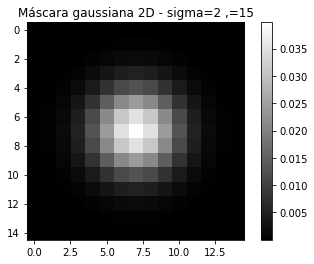

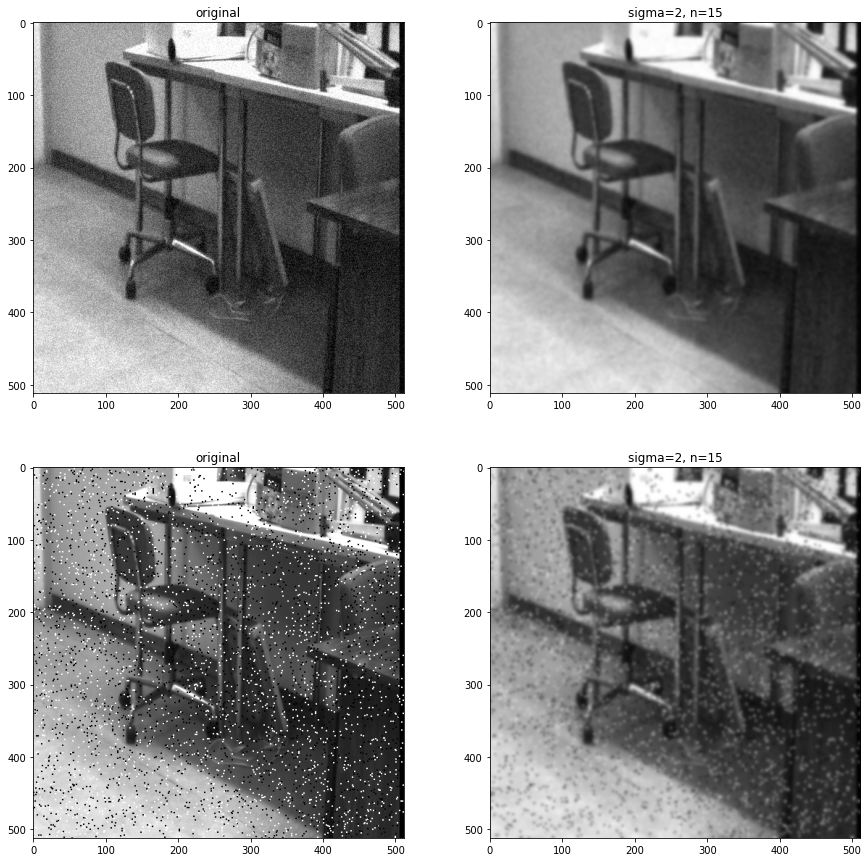

In [4]:
# Cargamos las imágenes para filtrar
original1 = "./imagenes/escgaus.bmp"
original1 = cv2.imread(original1, cv2.IMREAD_GRAYSCALE)
original2 = "./imagenes/escimp5.bmp"
original2 = cv2.imread(original2, cv2.IMREAD_GRAYSCALE)

# Parámetros para la máscara gaussiana (n>=5*sigma)
sigma = 2
n = 15

# Contruimos la máscara o kernel 2D para el filtrado y la mostramos
masc = masc_gaus(sigma, n)
kernel2d = np.outer(masc,masc)
print(masc)
plt.imshow(kernel2d,cmap='gray')
plt.title("Máscara gaussiana 2D - sigma=2 ,=15")
plt.colorbar()

# Utilizamos una función de filtrado bidimensional para nuestras imágenes 2D
photo1 = scipy.ndimage.convolve1d(original1, masc, axis=0)
photo1 = scipy.ndimage.convolve1d(photo1, masc, axis=1)
photo2 = scipy.ndimage.convolve1d(original2, masc, axis=0)
photo2 = scipy.ndimage.convolve1d(photo2, masc, axis=1)

# Imágenes resultado
f, axs = plt.subplots(2, 2, figsize=(15,15))
axs[0,0].set_title('original')
axs[0,0].imshow(original1,cmap='gray')
axs[0,1].set_title('sigma=2, n=15')
axs[0,1].imshow(photo1,cmap='gray')
axs[1,0].set_title('original')
axs[1,0].imshow(original2,cmap='gray')
axs[1,1].set_title('sigma=2, n=15')
axs[1,1].imshow(photo2,cmap='gray')

### Revisión de resultados con distintas parejas de parametros
Ahora vamos a revisar algunos resultados para distintos valores de sigma y n

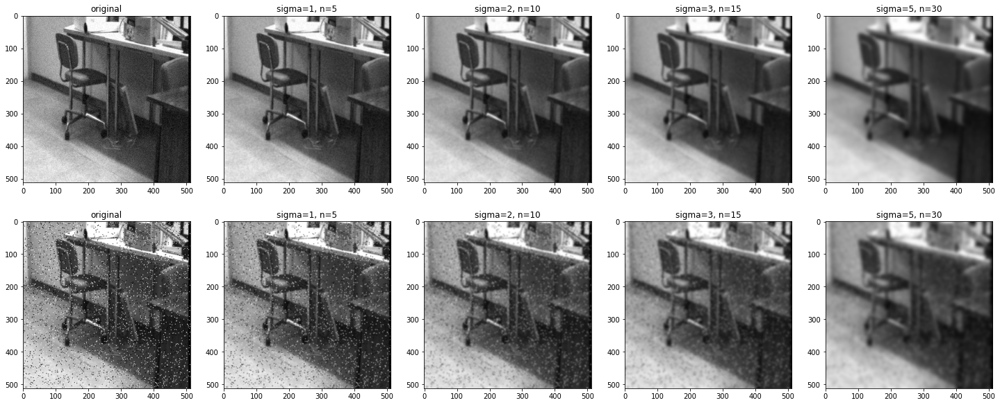

In [5]:
# Otros resultados con diferentes sigma y n:
sigma = 1
n = 5
masc = masc_gaus(sigma, n)
photo01 = scipy.ndimage.convolve1d(original1, masc, axis=0)
photo01 = scipy.ndimage.convolve1d(photo01, masc, axis=1)
photo02 = scipy.ndimage.convolve1d(original2, masc, axis=0)
photo02 = scipy.ndimage.convolve1d(photo02, masc, axis=1)

sigma = 2
n = 10
masc = masc_gaus(sigma, n)
photo1 = scipy.ndimage.convolve1d(original1, masc, axis=0)
photo1 = scipy.ndimage.convolve1d(photo1, masc, axis=1)
photo2 = scipy.ndimage.convolve1d(original2, masc, axis=0)
photo2 = scipy.ndimage.convolve1d(photo2, masc, axis=1)

sigma = 3
n = 15
masc = masc_gaus(sigma, n)
photo3 = scipy.ndimage.convolve1d(original1, masc, axis=0)
photo3 = scipy.ndimage.convolve1d(photo3, masc, axis=1)
photo4 = scipy.ndimage.convolve1d(original2, masc, axis=0)
photo4 = scipy.ndimage.convolve1d(photo4, masc, axis=1)

sigma = 5
n = 30
masc = masc_gaus(sigma, n)
photo5 = scipy.ndimage.convolve1d(original1, masc, axis=0)
photo5 = scipy.ndimage.convolve1d(photo5, masc, axis=1)
photo6 = scipy.ndimage.convolve1d(original2, masc, axis=0)
photo6 = scipy.ndimage.convolve1d(photo6, masc, axis=1)

f, axs = plt.subplots(2, 5, figsize=(25,10))
axs[0,0].set_title('original')
axs[0,0].imshow(original1,cmap='gray')
axs[0,1].set_title('sigma=1, n=5')
axs[0,1].imshow(photo01,cmap='gray')
axs[0,2].set_title('sigma=2, n=10')
axs[0,2].imshow(photo1,cmap='gray')
axs[0,3].set_title('sigma=3, n=15')
axs[0,3].imshow(photo3,cmap='gray')
axs[0,4].set_title('sigma=5, n=30')
axs[0,4].imshow(photo5,cmap='gray')

axs[1,0].set_title('original')
axs[1,0].imshow(original2,cmap='gray')
axs[1,1].set_title('sigma=1, n=5')
axs[1,1].imshow(photo02,cmap='gray')
axs[1,2].set_title('sigma=2, n=10')
axs[1,2].imshow(photo2,cmap='gray')
axs[1,3].set_title('sigma=3, n=15')
axs[1,3].imshow(photo4,cmap='gray')
axs[1,4].set_title('sigma=5, n=30')
axs[1,4].imshow(photo6,cmap='gray')

Como era de esperar, puede verse en el resultado que el filtro gaussiano puede eliminar el ruido gaussiano suavizando la imagen y emborronandola un poco. Sin embargo, si se aplica a una imagen con ruido impulsivo, este permanece en la imagen a pesar del emborronado.

Esto se cumple tanto para los valores mostrados de tamaño y varianza del filtro, como para valores superior, habiendose comprobado hasta los valores de tamañño 30 y varianza 5. Al aumentar la varianza y el tamaño (la varianza aumenta la fuerza del suavizado y el tamaño la cantidad de píxeles tenidos en cuenta) es que se emborrona más la imagen. 

Con valores muy altos de varianza y tamaño teniendo en cuenta la recomendación de n=5*sigma(sigma=10, n=50) se puede llegar a eliminar el ruido impulsivo al redistribuirlo entre los píxeles, pero la imagen pierde demasiadas propiedades por el suavizado tan fuerte. Lo que parecen dar a entender los resultados, es que el ruido impulsivo pasa a ser gaussiano al pasar de afectar a pixeles determinados a afectar a todos los pixeles.

## **Ejercicio 2.** 

Escribe una función ``masc_deriv_gaus(sigma, n)`` que construya una máscara de una dimensión de un
filtro derivada del gaussiano de tamaño *n* y varianza σ. Convierte de RGB a escala de grises y filtra la imagen ``telefonica.jpg`` con filtros bidimensionales de derivada
del gaussiano para extraer los bordes de la imagen. Prueba con diferentes valores de *n* y/o σ.

Muestra y discute los resultados. Pinta alguna de las máscaras construidas.

### Función máscara derivada del gaussiano
Función que devuelve una máscara unidimensional de la derivada del gaussiano con tamaño n y varianza sigma.

In [5]:
def masc_deriv_gaus(sigma, n):
  y = np.ogrid[-(n-1)/2:(n-1)/2 + 1]
  # Aplicamos la derivada a la gaussiana y utilizamos la expresión resultante para construir la mascara
  mascara = -( (y) / (sigma**2)) * np.exp(-( (y**2) / (2*sigma**2)))
  return mascara

Algunas pruebas para comprobar la máscara. 

La suma de los valores no llega a ser 0, pero el valor resultado es de un orden tan pequeño que puede considerarse equivalente a 0 (exponente -17). 

In [7]:
aux1 = masc_deriv_gaus(2,10) 
aux2 = masc_deriv_gaus(3,15) 
print("masc_deriv_gaus(2,10) ",aux1, ":: suma de los valores =", aux1.sum())
print("-------")
print("masc_deriv_gaus(2,15) ",aux2, ":: suma de los valores =", aux2.sum())
print("-------")
aux3 = np.outer(aux1,aux1)
print("Suma de valores del filtro bidimensional =",aux3.sum())

masc_deriv_gaus(2,10)  [ 0.08950445  0.18923202  0.28614585  0.28306485  0.12115415 -0.12115415
 -0.28306485 -0.28614585 -0.18923202 -0.08950445] :: suma de los valores = 1.3877787807814457e-17
-------
masc_deriv_gaus(2,15)  [ 0.05112219  0.09022352  0.138529    0.18271657  0.20217689  0.17794165
  0.10510661 -0.         -0.10510661 -0.17794165 -0.20217689 -0.18271657
 -0.138529   -0.09022352 -0.05112219] :: suma de los valores = -9.020562075079397e-17
-------
Suma de valores del filtro bidimensional = -1.5612511283791264e-17


### Aplicación del filtro y ejemplo para una pareja de parámetros sigma, n
Bloque para crear y aplicar el filtrado de la derivada del gaussiano. Para la creación del filtro vertical, se aplica el producto exterior entre la mascara gaussiana anterior y la derivada de la gaussiana, mientras que si cambiamos el orden de los factores obtenemos el filtro horizontal. 

Debido al funcionamiento de este filtro, solo es capaz de extraer (o de pintar) los bordes de la imagen que cumplen que el paso de blancos a negros se produce en la misma dirección y sentido que en los kernels que se le aplican: blanco-negro : izda-dcha o arriba-abajo. 

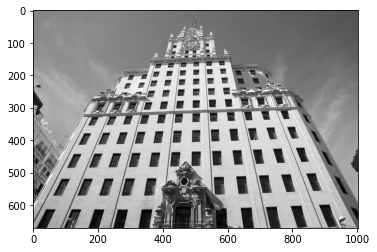

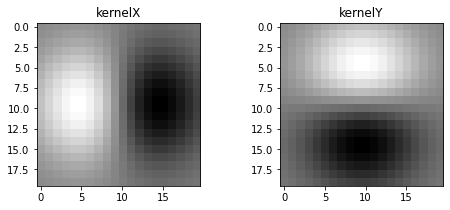

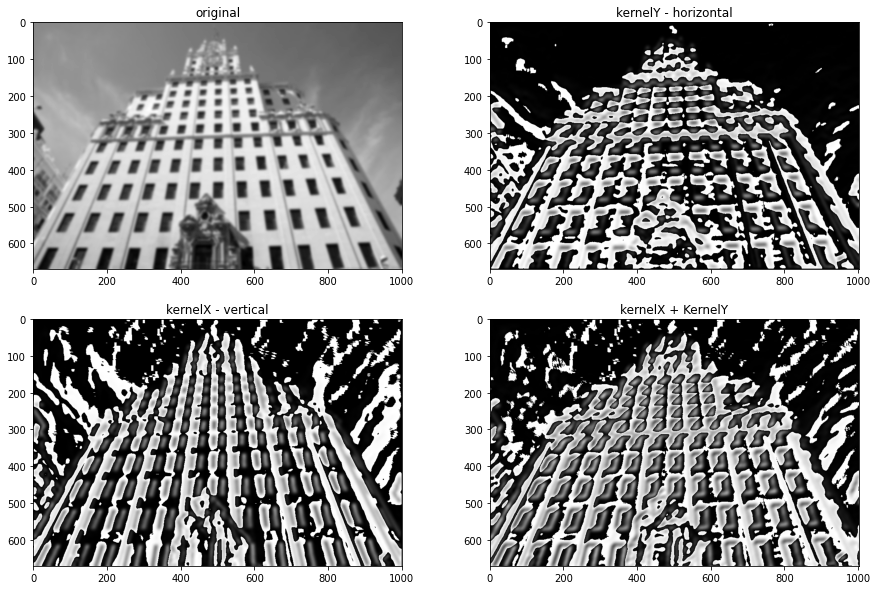

In [8]:
# Cargamos la imagen a filtrar y la pasamos a escala de grises
original = "./imagenes/telefonica.jpg"
gray_original = cv2.imread(original, cv2.IMREAD_GRAYSCALE)
plt.imshow(gray_original,cmap='gray')

# Contruimos la mascara gaussiana y la derivada de la gaussiana para luego construir los kernels 
# 2D con unos valores que devuelven un kernel 2D cuyo aspecto es el más parecido que hemos encontrado
# al visto en clase y presente en las transparencias
sigma = 5
n = 20
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
kernelX=np.outer(gaussianMasc,gaussianDer)
kernelY=np.outer(gaussianDer,gaussianMasc)

f, axs = plt.subplots(1, 2, figsize=(8,3))
axs[0].set_title('kernelX')
axs[0].imshow(kernelX,cmap='gray')
axs[1].set_title('kernelY')
axs[1].imshow(kernelY,cmap='gray')

# Vamos a aplicar la convolución combinando el filtro gaussiano para el ruido en una dirección y el
# filtro derivada del gaussiano para la detección de bordes en la dirección ortogonal mediante
# el parámetro axis de la función. De esta forma, efectuamos el filtro tal y como hemos visto en clase
# Cabe mencionar que suavizando la imagen previamente se consigue una pequeña mejor al suavizar la imagen,
# pero esto por si solo no es suficiente para mejorar los resultados, que quedan distorsionados e incluso peores
sigma = 3
n = 15
gaussianMasc = masc_gaus(sigma,n)

gray_original_gm = scipy.ndimage.convolve1d(gray_original, gaussianMasc, axis=0)
gray_original_gm = scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=1)

photo7 =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=1)
photo7 =scipy.ndimage.convolve1d(photo7, gaussianDer, axis=0)

photo8 =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=0)
photo8 =scipy.ndimage.convolve1d(photo8, gaussianDer, axis=1)

photo9 = photo7 + photo8

# Imágenes resultado
f, axs = plt.subplots(2, 2, figsize=(15,10))
axs[0,0].set_title('original')
axs[0,0].imshow(gray_original_gm,cmap='gray')
axs[0,1].set_title('kernelY - horizontal')
axs[0,1].imshow(photo7,cmap='gray')
axs[1,0].set_title('kernelX - vertical')
axs[1,0].imshow(photo8,cmap='gray')
axs[1,1].set_title('kernelX + KernelY')
axs[1,1].imshow(photo9,cmap='gray')

Cómo se puede apreciar, los resultados son bastante malos. Está claro que sobre esta imagen, con estas máscaras para la combinación de parámetros escogida, no se consiguen extraer los bordes de forma que la imagen final tenga sentido. El filtrado detecta demasiados bordes y genera una imagen llena de ruido y con los bordes demasiado gruesos y deformados. Sin embargo, vamos a ver que con unos parámetros diferentes, en donde la varianza es superior al tamaño n de la máscara, sí que se pueden conseguir resultados razonables

Cabe mencionar que con las funciones de filtrado de OpenCV y tanto los mismos kernels como las mismas máscaras unidimensionales para el filtrado separado, los resultados son significativamente superiores. Se consiguen filtrar los bordes de forma mucho más exacta, sin apenas ruido ni distorsión en los mismos. Hemos dejado una parte al final del ejercicio para mostrarlo, ya que estos dos primeros ejercicio los hicimos por error con estas funciones de OpenCV y nos ha parecido interesante.

### Revisión de resultados con distintas parejas de parametros
En este bloque vamos a ver que se pueden merjorar mucho los resultados modificando estos parámetros de forma que el valor de la varianza sea superior al del tamaño del filtro. El kernel cambia mucho su forma y pierde capacidad para detectar bordes, pero esto es exactamente lo que necesitamos porque con los valores anteriores se detectaban demasiados bordes y la detección de bordes quedaba llena de ruido. 

Lo que vamos a hacer es limitar tanto la capacidad de detección de los bordes que únicamente tenga en cuenta aquellos en los que el cambio de nivel de gris sea muy acentuado. Para ello, lo que hacemos es reducir mucho el tamaño de la máscara (y del kernel que formaría) para que tenga en cuenta pixeles muy cercano, a la vez que mantenemos o aumentamos el valor de la varianza para aumentar la diferencia entre niveles de gris que deja pasar el filtro. Además, antes de esto trataremos de suavizar la imagen para emborronar de forma leve las texturas de las superficies y tratar de evitar que se generen bordes debido a las mismas. En caso de nohacer un suavizado adicional previo a la imagen, cambian un poco los parámetros que dan mejores resultados, estando estos entre sigma=9, n=5 y sigma=5 n=3

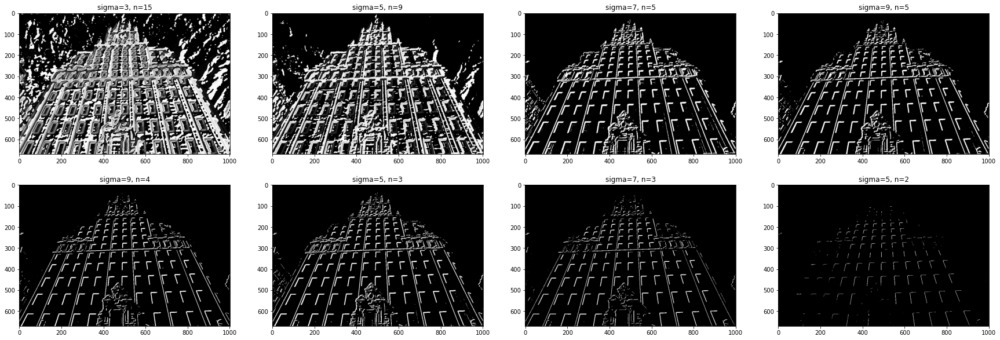

In [9]:
# Suavizamos levemente la imagen
sigma = 1
n = 5
gaussianMasc = masc_gaus(sigma,n)
gray_original_gm = scipy.ndimage.convolve1d(gray_original, gaussianMasc, axis=0)
gray_original_gm = scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=1)

# Parámetros para las máscaras gaussianas
sigma = 3
n = 15
# Contruimos la mascara gaussiana y la derivada de la gaussiana y aplicamos filtrado con las máscaras
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
auxV =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=1)
auxV =scipy.ndimage.convolve1d(auxV, gaussianDer, axis=0)
auxH =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=0)
auxH =scipy.ndimage.convolve1d(auxH, gaussianDer, axis=1)
photo13 = auxV + auxH

sigma = 5
n = 9
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
auxV =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=1)
auxV =scipy.ndimage.convolve1d(auxV, gaussianDer, axis=0)
auxH =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=0)
auxH =scipy.ndimage.convolve1d(auxH, gaussianDer, axis=1)
photo14 = auxV + auxH

sigma = 7
n = 5
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
auxV =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=1)
auxV =scipy.ndimage.convolve1d(auxV, gaussianDer, axis=0)
auxH =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=0)
auxH =scipy.ndimage.convolve1d(auxH, gaussianDer, axis=1)
photo15 = auxV + auxH

sigma = 9
n = 5
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
auxV =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=1)
auxV =scipy.ndimage.convolve1d(auxV, gaussianDer, axis=0)
auxH =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=0)
auxH =scipy.ndimage.convolve1d(auxH, gaussianDer, axis=1)
photo16 = auxV + auxH

sigma = 9
n = 4
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
auxV =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=1)
auxV =scipy.ndimage.convolve1d(auxV, gaussianDer, axis=0)
auxH =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=0)
auxH =scipy.ndimage.convolve1d(auxH, gaussianDer, axis=1)
photo17 = auxV + auxH

sigma = 5
n = 3
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
auxV =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=1)
auxV =scipy.ndimage.convolve1d(auxV, gaussianDer, axis=0)
auxH =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=0)
auxH =scipy.ndimage.convolve1d(auxH, gaussianDer, axis=1)
photo18 = auxV + auxH

sigma = 7
n = 3
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
auxV =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=1)
auxV =scipy.ndimage.convolve1d(auxV, gaussianDer, axis=0)
auxH =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=0)
auxH =scipy.ndimage.convolve1d(auxH, gaussianDer, axis=1)
photo19 = auxV + auxH

sigma = 5
n = 2
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
auxV =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=1)
auxV =scipy.ndimage.convolve1d(auxV, gaussianDer, axis=0)
auxH =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=0)
auxH =scipy.ndimage.convolve1d(auxH, gaussianDer, axis=1)
photo20 = auxV + auxH


# Imágenes resultado
f, axs = plt.subplots(2, 4, figsize=(30,10))
axs[0,0].set_title('sigma=3, n=15')
axs[0,0].imshow(photo13,cmap='gray')
axs[0,1].set_title('sigma=5, n=9')
axs[0,1].imshow(photo14,cmap='gray')
axs[0,2].set_title('sigma=7, n=5')
axs[0,2].imshow(photo15,cmap='gray')
axs[0,3].set_title('sigma=9, n=5')
axs[0,3].imshow(photo16,cmap='gray')
axs[1,0].set_title('sigma=9, n=4')
axs[1,0].imshow(photo17,cmap='gray')
axs[1,1].set_title('sigma=5, n=3')
axs[1,1].imshow(photo18,cmap='gray')
axs[1,2].set_title('sigma=7, n=3')
axs[1,2].imshow(photo19,cmap='gray')
axs[1,3].set_title('sigma=5, n=2')
axs[1,3].imshow(photo20,cmap='gray')

### Kernels simétricos, bordes con cambio en la escala de grises en sentidos contrarios
Obteniendo el simétrico con respecto al centro, conseguimos respectivamente dos nuevos kernels kernelXS y kernelYS. Con ellos, podemos extraer los bordes, verticales y horizontales respectivamente, cuyo sentido es el contrario al que conseguiamos con los kernels originales kernelX y kernelY. Para ello basta con utilizar para cada producto exterior la máscara gaussiana cambiada de signo

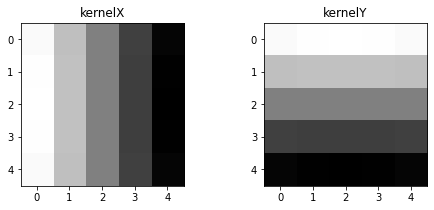

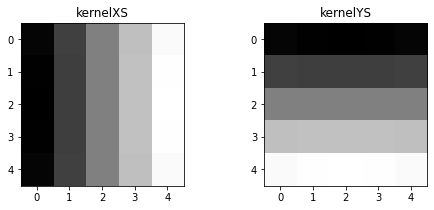

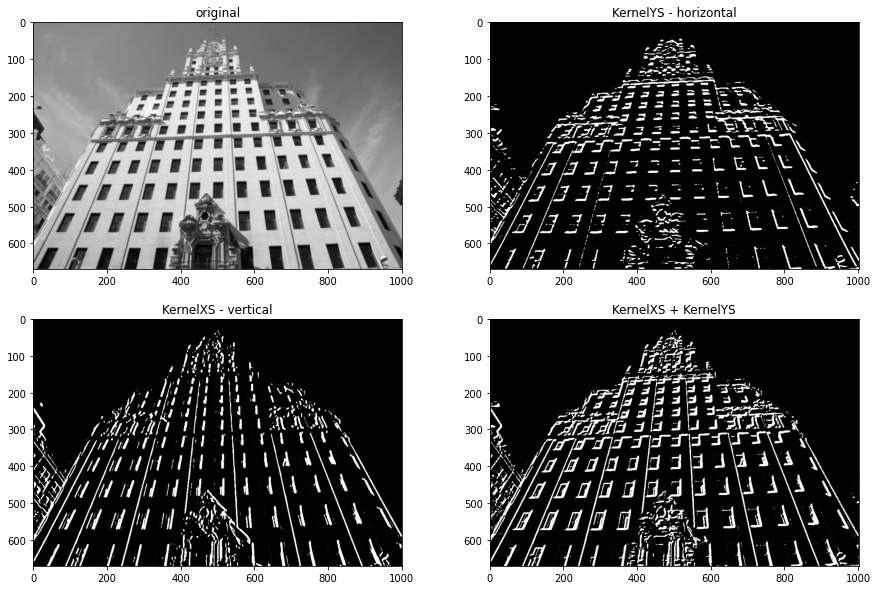

In [10]:
sigma = 7
n = 5
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
kernelX=np.outer(gaussianMasc,gaussianDer)
kernelY=np.outer(gaussianDer,gaussianMasc)

f, axs = plt.subplots(1, 2, figsize=(8,3))
axs[0].set_title('kernelX')
axs[0].imshow(kernelX,cmap='gray')
axs[1].set_title('kernelY')
axs[1].imshow(kernelY,cmap='gray')

gaussianDerS = -gaussianDer
kernelXS=np.outer(gaussianMasc,gaussianDerS)
kernelYS=np.outer(gaussianDerS,gaussianMasc)

f, axs = plt.subplots(1, 2, figsize=(8,3))
axs[0].set_title('kernelXS')
axs[0].imshow(kernelXS,cmap='gray')
axs[1].set_title('kernelYS')
axs[1].imshow(kernelYS,cmap='gray')

photo21 =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=1)
photo21 =scipy.ndimage.convolve1d(photo21, gaussianDerS, axis=0)
photo22 =scipy.ndimage.convolve1d(gray_original_gm, gaussianMasc, axis=0)
photo22 =scipy.ndimage.convolve1d(photo22, gaussianDerS, axis=1)
photo23 = photo21 + photo22

# Imágenes resultado
f, axs = plt.subplots(2, 2, figsize=(15,10))
axs[0,0].set_title('original')
axs[0,0].imshow(gray_original_gm,cmap='gray')
axs[0,1].set_title('KernelYS - horizontal')
axs[0,1].imshow(photo21,cmap='gray')
axs[1,0].set_title('KernelXS - vertical')
axs[1,0].imshow(photo22,cmap='gray')
axs[1,1].set_title('KernelXS + KernelYS')
axs[1,1].imshow(photo23,cmap='gray')

Con estos 4 kernels, se han conseguido extraer una gran mayoría de los bordes de la imagen, y sumando las 4 imágenes obtenidas podemos obtener una imagen en la que se ven prácticamente todos los bordes. Usamos un umbral para dejar pasar los valores mayores a 0, ya que 0 es el negro que representa el fondo, y los valores superiores los que representan los bordes, y de esa forma crear una imagen final de ceros y unos qye sea visible. Si se suman directamente, la función imshow no es capaz de representar el resultado porque los pixeles de los bordes toman valores demasiado elevados

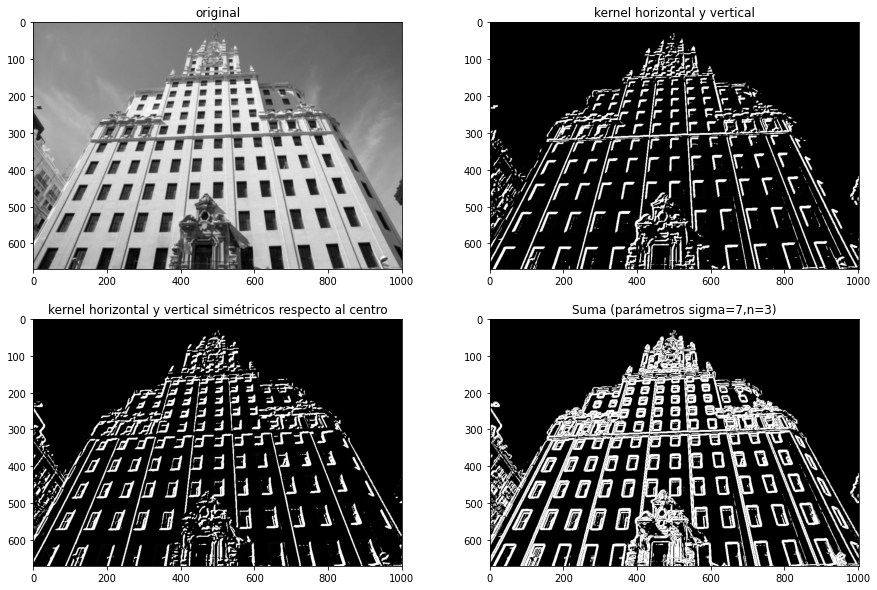

In [11]:
threshold = 0
photo24 = ((photo15 > threshold) + (photo23 > threshold)) > 0 # Imagen binaria 0-1

f, axs = plt.subplots(2, 2, figsize=(15,10))
axs[0,0].set_title('original')
axs[0,0].imshow(gray_original_gm,cmap='gray')
axs[0,1].set_title('kernel horizontal y vertical')
axs[0,1].imshow(photo15,cmap='gray')
axs[1,0].set_title('kernel horizontal y vertical simétricos respecto al centro')
axs[1,0].imshow(photo23,cmap='gray')
axs[1,1].set_title('Suma (parámetros sigma=7,n=3)')
axs[1,1].imshow(photo24,cmap='gray')

Vamos a dejar los resultados devueltos mediante el filtrado de sepFilter2D (son similares a los de filter2D con el kernel del producto exterior de las 2 máscaras) de OpenCV porque los hicimos así por error primero, y nos parece extraño. 

Fundamentalmente, para mismos valores de sigma y n, los resultados son completamente dispares, diríamos que considerablemente mejores en el caso de OpenCV. Hemos visto diferencias en las funciones de OpenCV respecto a convolve / convolve1d de Scipy, que realizan una convolución básica, pero no terminamos de comprender que den lugar a esta enorme diferencia en la cantidad de ruido y bordes detectados y la mala calidad de las imágenes.

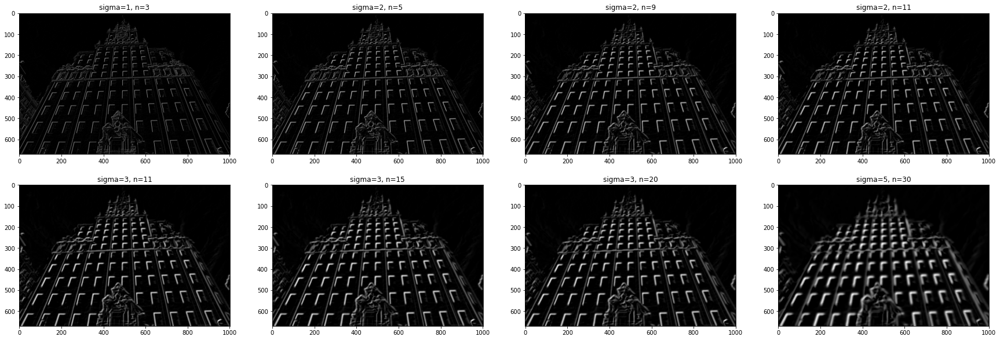

In [12]:
# Parámetros para las máscaras gaussianas
sigma = 1
n = 3
# Contruimos la mascara gaussiana y la derivada de la gaussiana y aplicamos filtrado con el kernel separable
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
photo25 = cv2.sepFilter2D(gray_original, -1, gaussianDer,gaussianMasc) + cv2.sepFilter2D(gray_original, -1, gaussianMasc,gaussianDer)

sigma = 2
n = 5
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
photo26 = cv2.sepFilter2D(gray_original, -1, gaussianDer,gaussianMasc) + cv2.sepFilter2D(gray_original, -1, gaussianMasc,gaussianDer)

sigma = 2
n = 9
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
photo27 = cv2.sepFilter2D(gray_original, -1, gaussianDer,gaussianMasc) + cv2.sepFilter2D(gray_original, -1, gaussianMasc,gaussianDer)

sigma = 2
n = 11
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
photo28 = cv2.sepFilter2D(gray_original, -1, gaussianDer,gaussianMasc) + cv2.sepFilter2D(gray_original, -1, gaussianMasc,gaussianDer)

sigma = 3
n = 11
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
photo29 = cv2.sepFilter2D(gray_original, -1, gaussianDer,gaussianMasc) + cv2.sepFilter2D(gray_original, -1, gaussianMasc,gaussianDer)

sigma = 3
n = 15
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
photo30 = cv2.sepFilter2D(gray_original, -1, gaussianDer,gaussianMasc) + cv2.sepFilter2D(gray_original, -1, gaussianMasc,gaussianDer)

sigma = 3
n = 20
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
photo31 = cv2.sepFilter2D(gray_original, -1, gaussianDer,gaussianMasc) + cv2.sepFilter2D(gray_original, -1, gaussianMasc,gaussianDer)

sigma = 5
n = 30
gaussianMasc = masc_gaus(sigma,n)
gaussianDer = masc_deriv_gaus(sigma, n)
photo32 = cv2.sepFilter2D(gray_original, -1, gaussianDer,gaussianMasc) + cv2.sepFilter2D(gray_original, -1, gaussianMasc,gaussianDer)


# Imágenes resultado
f, axs = plt.subplots(2, 4, figsize=(30,10))
axs[0,0].set_title('sigma=1, n=3')
axs[0,0].imshow(photo25,cmap='gray')
axs[0,1].set_title('sigma=2, n=5')
axs[0,1].imshow(photo26,cmap='gray')
axs[0,2].set_title('sigma=2, n=9')
axs[0,2].imshow(photo27,cmap='gray')
axs[0,3].set_title('sigma=2, n=11')
axs[0,3].imshow(photo28,cmap='gray')
axs[1,0].set_title('sigma=3, n=11')
axs[1,0].imshow(photo29,cmap='gray')
axs[1,1].set_title('sigma=3, n=15')
axs[1,1].imshow(photo30,cmap='gray')
axs[1,2].set_title('sigma=3, n=20')
axs[1,2].imshow(photo31,cmap='gray')
axs[1,3].set_title('sigma=5, n=30')
axs[1,3].imshow(photo32,cmap='gray')

Se puede ver como los distintos valores afentan al filtrado realizado. El filtro gaussiano de paso bajo o suavizado está jugando un papel para suavizar la imagen y eliminar posible ruido, y los cambios de varianza y tamaño afectan a la imagen de la misma forma que antes. A mayor varianza mayor fuerza en el suavizado, y a mayor tamaño más cantidad de píxeles vecinos se tienen en cuenta (lo cual aumenta también el emborronamient). Al aumentar, se emborrona más la imagen, y el filtro de la derivada del gaussiano responde con unos bordes de mayor "grosor". Para los incremenos iniciales en donde varianza y tamaño son reducidos, aumentar tanto uno como el otro mejora la detección de bordes y los hace más visibles. Sin embargo, a partir de ciertos valores empiezan a emborronarse. 

## **Ejercicio 3.** 
Utiliza la función ``median_filter`` del paquete ``scipy.ndimage``
que realiza el filtrado de la imagen con un filtro de la mediana de tamaño *n* × *n*.

Muestra y discute los resultados para diferentes valores del parámetro *n* en ambas imágenes. Compáralos con los obtenidos en el Ejercicio 1.

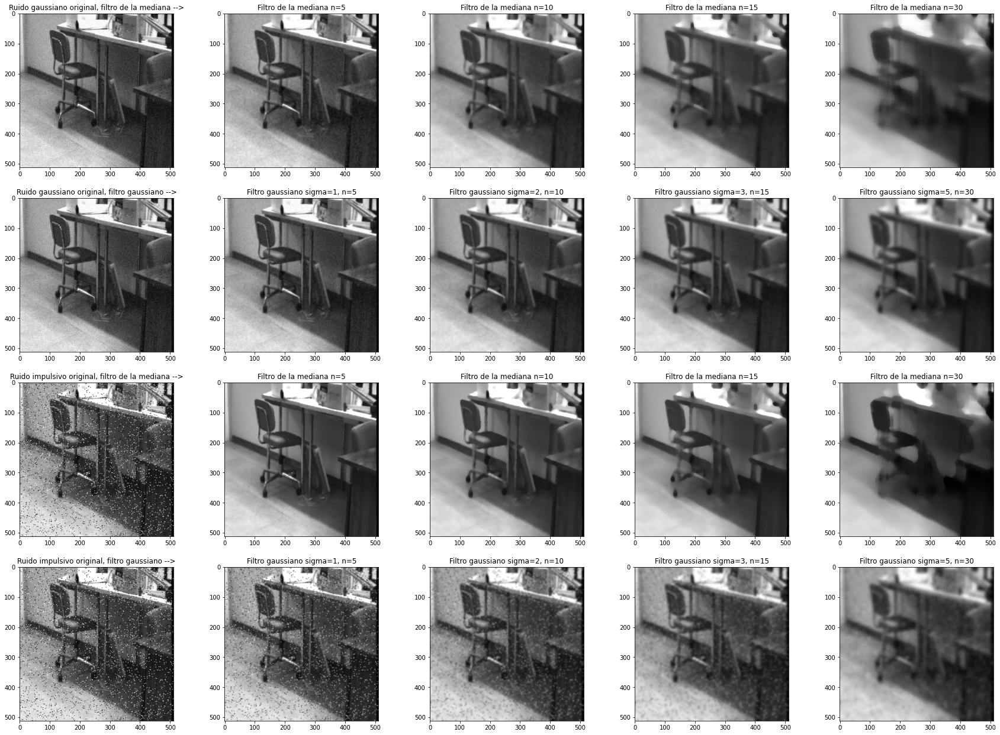

In [13]:
# Tenemos las imágenes del ej1 original1 y original2

photo33 = scipy.ndimage.median_filter(original1, size=5)
photo34 = scipy.ndimage.median_filter(original1, size=10)
photo35 = scipy.ndimage.median_filter(original1, size=15)
photo36 = scipy.ndimage.median_filter(original1, size=30)

photo37 = scipy.ndimage.median_filter(original2, size=5)
photo38 = scipy.ndimage.median_filter(original2, size=10)
photo39 = scipy.ndimage.median_filter(original2, size=15)
photo40 = scipy.ndimage.median_filter(original2, size=30)

f, axs = plt.subplots(4, 5, figsize=(30,22))
axs[0,0].set_title('Ruido gaussiano original, filtro de la mediana -->')
axs[0,0].imshow(original1,cmap='gray')
axs[0,1].set_title('Filtro de la mediana n=5')
axs[0,1].imshow(photo33,cmap='gray')
axs[0,2].set_title('Filtro de la mediana n=10')
axs[0,2].imshow(photo34,cmap='gray')
axs[0,3].set_title('Filtro de la mediana n=15')
axs[0,3].imshow(photo35,cmap='gray')
axs[0,4].set_title('Filtro de la mediana n=30')
axs[0,4].imshow(photo36,cmap='gray')

axs[1,0].set_title('Ruido gaussiano original, filtro gaussiano -->')
axs[1,0].imshow(original1,cmap='gray')
axs[1,1].set_title('Filtro gaussiano sigma=1, n=5')
axs[1,1].imshow(photo01,cmap='gray')
axs[1,2].set_title('Filtro gaussiano sigma=2, n=10')
axs[1,2].imshow(photo1,cmap='gray')
axs[1,3].set_title('Filtro gaussiano sigma=3, n=15')
axs[1,3].imshow(photo3,cmap='gray')
axs[1,4].set_title('Filtro gaussiano sigma=5, n=30')
axs[1,4].imshow(photo5,cmap='gray')

#########
axs[2,0].set_title('Ruido impulsivo original, filtro de la mediana -->')
axs[2,0].imshow(original2,cmap='gray')
axs[2,1].set_title('Filtro de la mediana n=5')
axs[2,1].imshow(photo37,cmap='gray')
axs[2,2].set_title('Filtro de la mediana n=10')
axs[2,2].imshow(photo38,cmap='gray')
axs[2,3].set_title('Filtro de la mediana n=15')
axs[2,3].imshow(photo39,cmap='gray')
axs[2,4].set_title('Filtro de la mediana n=30')
axs[2,4].imshow(photo40,cmap='gray')

axs[3,0].set_title('Ruido impulsivo original, filtro gaussiano -->')
axs[3,0].imshow(original2,cmap='gray')
axs[3,1].set_title('Filtro gaussiano sigma=1, n=5')
axs[3,1].imshow(photo02,cmap='gray')
axs[3,2].set_title('Filtro gaussiano sigma=2, n=10')
axs[3,2].imshow(photo2,cmap='gray')
axs[3,3].set_title('Filtro gaussiano sigma=3, n=15')
axs[3,3].imshow(photo4,cmap='gray')
axs[3,4].set_title('Filtro gaussiano sigma=5, n=30')
axs[3,4].imshow(photo6,cmap='gray')

### Revisión de resultados con distintas parejas de parámetros
Se puede extraer una serie de conclusiones revisando los resultados, que están en consonancia con lo visto acerca estos dos tipos de filtros y de ruidos:

*   Por un lado, el filtro gaussiano, que es lineal y de paso bajo, permite eliminar o reducir el ruido gaussiano que contamina todos los pixeles de la imagen. Lo hace estableciendo los valores de cada pixel de la imagen filtrada en función de su valor y el de sus vecinos de acuerdo a un promediado ponderado mediante la función gaussiana. En definitiva, compensa el ruido gaussiano suavizando la imagen al promediar entre los n píxeles vecinos con una "fuerza" proporcional al valor de sigma.
 
 * Funciona adecuadamente con la primera imagen porque contiene ruido gaussiano, dando resultados que varían en función de los parámetros de varianza ($sigma$) y tamaño ($n$). Cuanto mayor sea la varianza y el tamaño, cumpliendose la recomendación $sigma \geq n$, mejor se elimina este tipo de ruido, aunque también se emborrona la imagen y se pierden parte de sus propiedades.

 * No funciona con la segunda imagen porque contiene ruido impulsivo que contamina únicamente algunos pixeles de la imagen. 
      
     *  Para valores elevados de sigma y n, da la sensación de que este ruido impulsivo cambia, tras aplicar el filtro, y empieza a parecerse al gaussiano. Esto puede deberse al cálculo promediado que se realiza, que provoca una repartición del ruido de los pixeles contaminado entre los pixeles vecinos a la vez que reduce el de los pixeles contaminado. Puede verse en el caso de $sigma=5$ y $n=30$.

*   Por otro lado, el filtro de la mediana, que es un filtro no lineal, permite eliminar o reducir el ruido impulsivo que contamina algunos pixeles de la imagen. Al tener en cuenta el valor de los vecinos y quedarse con el elemento mediana, permite eliminar los valores atípicos de un pixel con respecto a sus vecinos.

 * No funciona con el ruido gaussiano, ya que por mucho que establezaca para cada pixel la mediana de los valores del mismo y de sus vecinos, siempre va a establecer un valor que va a estar contaminado por ruido gaussiano, ya que tal es la naturaleza de este tipo de ruido. 
     * Ocurre que con valores suficientemente elevados de $n$ la imagen filtrada acaba pareciendo no contaminada. Esto puede deberse a que, al quedarse con la mediana cada pixel, se pierden valores y la imagen se suaviza tanto que queda demasiado emborronada como para percibir si hay o no ruido gaussiano.

 * Funciona muy bien con el ruido impulsivo de la imagen planteada. Incluso para el valor más bajo de $n=5$ probado, es capaz de eliminar la mayor parte del ruido impulsivo, sin apenas perder propiedades de la imagen. Subiendo a 10, ya se elimna el ruido. Cuanto mayor sea el tamaño $n$ del filtro, mejor elimina este tipo de ruido, pero también causa emborronamiento de la imagen y pérdida de sus propiedades, por lo que valores cercanos a 10 son los que mejor resultado dan para esta imagen.

## **Ejercicio 4.** 
Utiliza la funcion ``cv2.bilateralFilter()`` de OpenCV para realizar el filtrado bilateral de una
imagen. Selecciona los parámetros adecuados y aplícalo a las imágenes ``tapiz.jpg``, ``escgaus.bmp`` y ``escimp5.bmp`` y otras que elijas tú.

Si llamamos $\sigma_r$ a la varianza de la gaussiana que controla la ponderación debida a la diferencia entre los valores de los píxeles y $\sigma_s$ a la varianza de la gaussiana que controla la ponderación debida a la posición de los píxeles. Responde a la siguientes preguntas:
* ¿Cómo se comporta el filtro bilateral cuando la varianza $\sigma_r$ es muy alta? ¿En este caso qué ocurre si $\sigma_s$ es alta o baja?
* ¿Cómo se comporta si $\sigma_r$ es muy baja? ¿En este caso cómo se comporta el filtro dependiendo si $\sigma_s$ es alta o baja?

Muestra y discute los resultados para distintos valores de los parámetros, tanto para las imágenes contaminadas con ruido gaussiano como impulsivo. Compáralos con los obtenidos en el Ejercicio 1.

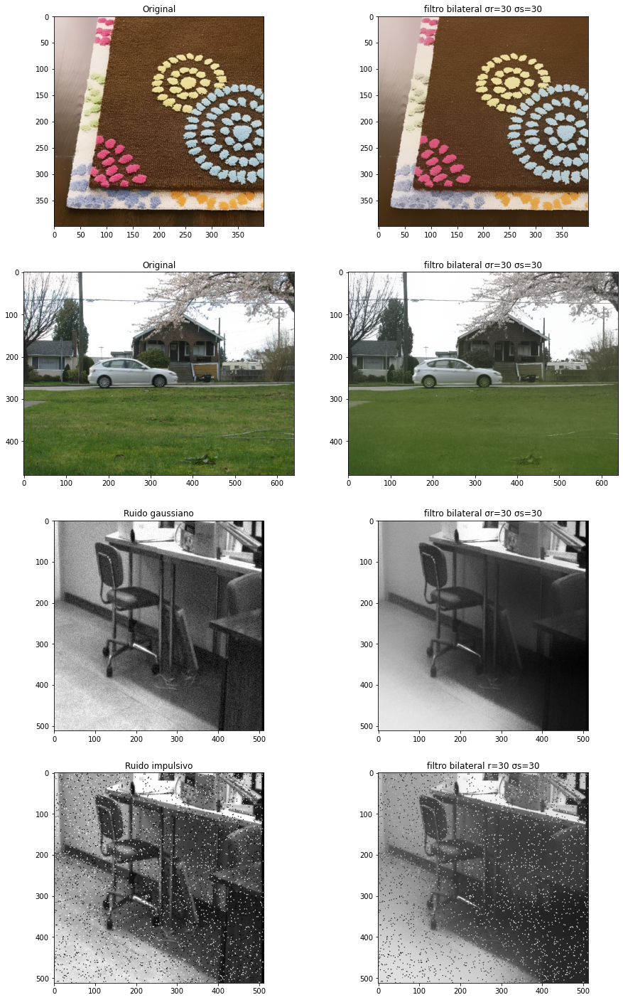

In [33]:
original1 = "./imagenes/escgaus.bmp"
original1 = cv2.imread(original1, cv2.IMREAD_GRAYSCALE)
original2 = "./imagenes/escimp5.bmp"
original2 = cv2.imread(original2, cv2.IMREAD_GRAYSCALE)

tapiz = "./imagenes/tapiz.png"
originalTapiz = cv2.cvtColor(cv2.imread(tapiz), cv2.COLOR_BGR2RGB)

car = "./imagenes/car.jpg"
originalCar = cv2.cvtColor(cv2.imread(car), cv2.COLOR_BGR2RGB)

# Para valores no positivos en el parámetro d, diámetro de vecindad, éste se
# calcula proporcionalmente a sigma_s, pero vamos a utilizar la recomendación de
# valor 9 para aplicaciones offline que consta en la especificación de la función
# ya que de otro modo se ralentiza enormemente la ejecución
d = -1
sigma_r = 50
sigma_s = 50
photo41 = cv2.bilateralFilter(originalTapiz,d,sigma_r,sigma_s)
photo42 = cv2.bilateralFilter(originalCar,d,sigma_r,sigma_s)
photo43 = cv2.bilateralFilter(original1,d,sigma_r,sigma_s)
photo44 = cv2.bilateralFilter(original2,d,sigma_r,sigma_s)

f, axs = plt.subplots(4, 2, figsize=(15,25))
axs[0,0].set_title('Original')
axs[0,0].imshow(originalTapiz)
axs[0,1].set_title('filtro bilateral σr=30 σs=30')
axs[0,1].imshow(photo41)
axs[1,0].set_title('Original')
axs[1,0].imshow(originalCar)
axs[1,1].set_title('filtro bilateral σr=30 σs=30')
axs[1,1].imshow(photo42)
axs[2,0].set_title('Ruido gaussiano')
axs[2,0].imshow(original1,cmap='gray')
axs[2,1].set_title('filtro bilateral σr=30 σs=30')
axs[2,1].imshow(photo43,cmap='gray')
axs[3,0].set_title('Ruido impulsivo')
axs[3,0].imshow(original2,cmap='gray')
axs[3,1].set_title('filtro bilateral r=30 σs=30')
axs[3,1].imshow(photo44,cmap='gray')

En primer lugar, hay que comentar que, debido al funcionamiento del filtro, existe un parámetro para determinar el diametro de vecindad de los pixeles, que es $d$. Como se ha explicado en el código, este parámetro se puede especificar con un valor no negativo valor, o computarse a partir de $\sigma_s$. Dado que establecerlo a un valor no negativo no calculado a partir de $\sigma_s$ elimina completamente las diferencias entre resultados con $\sigma_r$ elevada, no lo hemos hecho. Esto desemboca en tiempo de ejecución muy altos para valores de $\sigma_s$ altos. La relación entre  $\sigma_s$ y $\sigma_r$ es que, aunque la primera determine la distancia de la vecindad $d$ y su influencia, solo se tendrán en cuenta los pixeles con valores suficientemente similares según lo que indique la segunda.

### Valores altos de $\sigma_r$



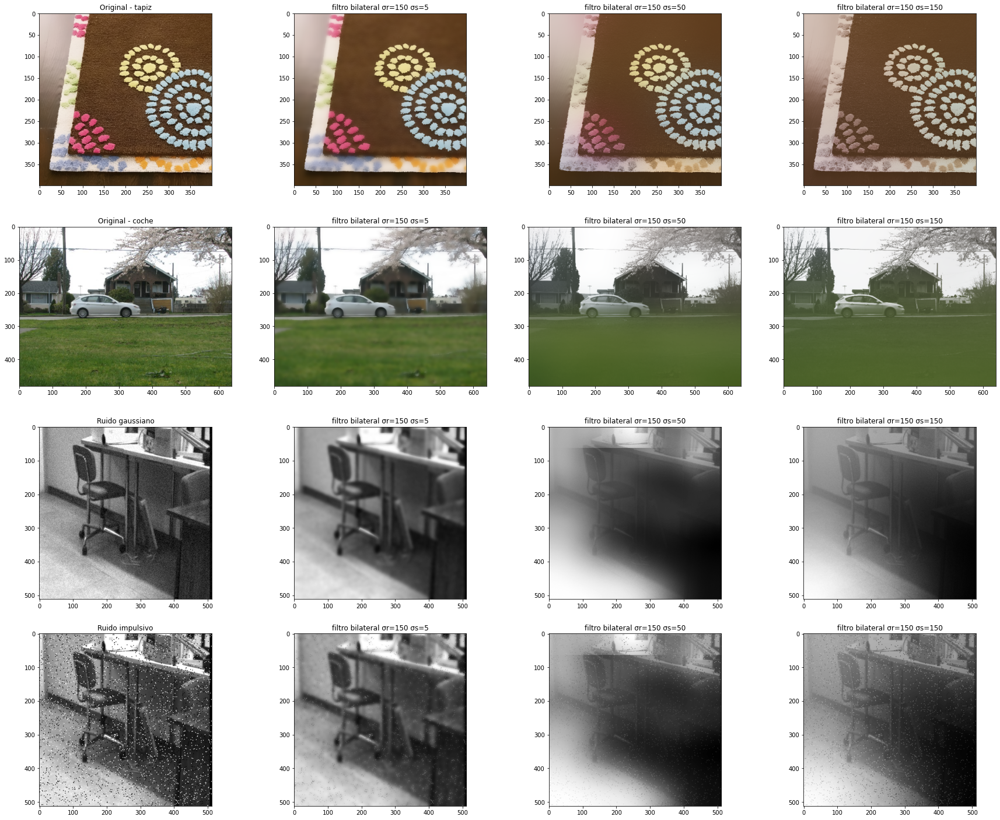

In [15]:
# Para valores no positivos en el parámetro d, diámetro de vecindad, éste se
# calcula proporcionalmente a sigma_s, pero hacer esto ralentiza muchísimo el 
# proceso cuando sigma_s es alto. Vamos a usarlo en cualquier caso, ya que sino
# el parámetro sigma_s pierde su utilidad al hacer referencia también a la distancia
# a la que los pixeles se influencian entre ellos
d = -1
sigma_r = 150
sigma_s = 5
photo41 = cv2.bilateralFilter(originalTapiz,d,sigma_r,sigma_s)
photo42 = cv2.bilateralFilter(originalCar,d,sigma_r,sigma_s)
photo43 = cv2.bilateralFilter(original1,d,sigma_r,sigma_s)
photo44 = cv2.bilateralFilter(original2,d,sigma_r,sigma_s)

sigma_s = 50
photo45 = cv2.bilateralFilter(originalTapiz,d,sigma_r,sigma_s)
photo46 = cv2.bilateralFilter(originalCar,d,sigma_r,sigma_s)
photo47 = cv2.bilateralFilter(original1,d,sigma_r,sigma_s)
photo48 = cv2.bilateralFilter(original2,d,sigma_r,sigma_s)

sigma_s = 150
photo49 = cv2.bilateralFilter(originalTapiz,d,sigma_r,sigma_s)
photo50 = cv2.bilateralFilter(originalCar,d,sigma_r,sigma_s)
photo51 = cv2.bilateralFilter(original1,d,sigma_r,sigma_s)
photo52 = cv2.bilateralFilter(original2,d,sigma_r,sigma_s)

f, axs = plt.subplots(4, 4, figsize=(30,25))
axs[0,0].set_title('Original - tapiz')
axs[0,0].imshow(originalTapiz)
axs[0,1].set_title('filtro bilateral σr=150 σs=5')
axs[0,1].imshow(photo41)
axs[0,2].set_title('filtro bilateral σr=150 σs=50')
axs[0,2].imshow(photo45)
axs[0,3].set_title('filtro bilateral σr=150 σs=150')
axs[0,3].imshow(photo49)
axs[1,0].set_title('Original - coche')
axs[1,0].imshow(originalCar)
axs[1,1].set_title('filtro bilateral σr=150 σs=5')
axs[1,1].imshow(photo42)
axs[1,2].set_title('filtro bilateral σr=150 σs=50')
axs[1,2].imshow(photo46)
axs[1,3].set_title('filtro bilateral σr=150 σs=150')
axs[1,3].imshow(photo50)
axs[2,0].set_title('Ruido gaussiano')
axs[2,0].imshow(original1,cmap='gray')
axs[2,1].set_title('filtro bilateral σr=150 σs=5')
axs[2,1].imshow(photo43,cmap='gray')
axs[2,2].set_title('filtro bilateral σr=150 σs=50')
axs[2,2].imshow(photo47,cmap='gray')
axs[2,3].set_title('filtro bilateral σr=150 σs=150')
axs[2,3].imshow(photo51,cmap='gray')
axs[3,0].set_title('Ruido impulsivo')
axs[3,0].imshow(original2,cmap='gray')
axs[3,1].set_title('filtro bilateral σr=150 σs=5')
axs[3,1].imshow(photo44,cmap='gray')
axs[3,2].set_title('filtro bilateral σr=150 σs=50')
axs[3,2].imshow(photo48,cmap='gray')
axs[3,3].set_title('filtro bilateral σr=150 σs=150')
axs[3,3].imshow(photo52,cmap='gray')

#### Resultados con $\sigma_r$ elevada

$\sigma_r$ es la varianza de la gaussiana que controla la ponderación debida a la diferencia entre los valores de los píxeles. Esto significa que valores mayores establecen que colores más lejanos del valor del pixel en su vecindad se mezclarán y surgirán áreas más grandes de colores muy similares, contaminandose con los valores de otras áreas de colores colindantes.

En los resultados se puede ver como se crean estas regiones grandes de colores muy similares. Estas regiones quedan separadas por bordes que separan zonas de la imagen que tienen colores distintos, siendo esta una de las ventajas de este filtrado, aunque es muy lento. Aparte de esto, se suaviza la imagen, mitigándose texturas, cosa que se nota especialmente en el caso de la imagen del tapiz, y emborronando un poco la imagen. Se elimina bien el ruido gaussiano de esta forma, a diferencia del impulsivo que apenas se suaviza un poco y sigue siendo muy notable.

Para valores muy bajos de $\sigma_s$, ocurre que el diámetro de vecindad se reduce mucho. Esto implica que no se tengan en cuenta píxeles muy lejanos, lo cual hace que estas regiones con colores muy similares no puedan ser demasiado grandes y, por ello, los colores de de regiones vecinas no se contaminan y los bordes entre regiones se pueden seguir apreciando. 

Para valores muy altos de $\sigma_s$, en concreto el mismo valor que $\sigma_r$, crece mucho el diámetro de vecindad. Al igual que antes, se suaviza la imagen, se elimina el ruido gaussiano y no se elimina el ruido impulsivo. La diferencia más grande, y que se ve a simple vista, es que los colores se empiezan a entremezclar entre regiones. Se puede ver facilmente en los bordados de la imagen del tapiz. 

Para valores intermedios entre ambos, en concreto para $\sigma_s = 50$, ocurre lo mismo que para valores altos pero de forma menos acentuada. Las regiones de colores se ven contaminadas por los valores de las regiones vecinas, aunque menos, y la imagen queda muy emborronada. Lo curioso en este caso es que la imagen resultante parece convervar peor sus propiedades que en el caso anterior de $\sigma_s$ alto, lo que se puede notar en las imágenes contaminadas por ruido y en la del coche. El caso es que no terminamos de comprender a qué se debe esto, pero se puede observar que el filtrado parece ser más potente, haciendo las texturas (imagen del tapiz) menos visibles que para valores altos. En las imágenes contaminadas nos da la sensación de que el motivo puede estar relacionado con la distribución de luz y sombras de la zona bajo la mesa, y que se debe a las características de la imagen, pero tampoco termina de cuadrar si se tienen en cuenta las otras dos imágenes en color. Además, cabe señalar que el ruido impulsivo, aunque visible, queda mejor filtrado que para valores altos o bajos de $\sigma_s$.


### Valores bajos de $\sigma_r$



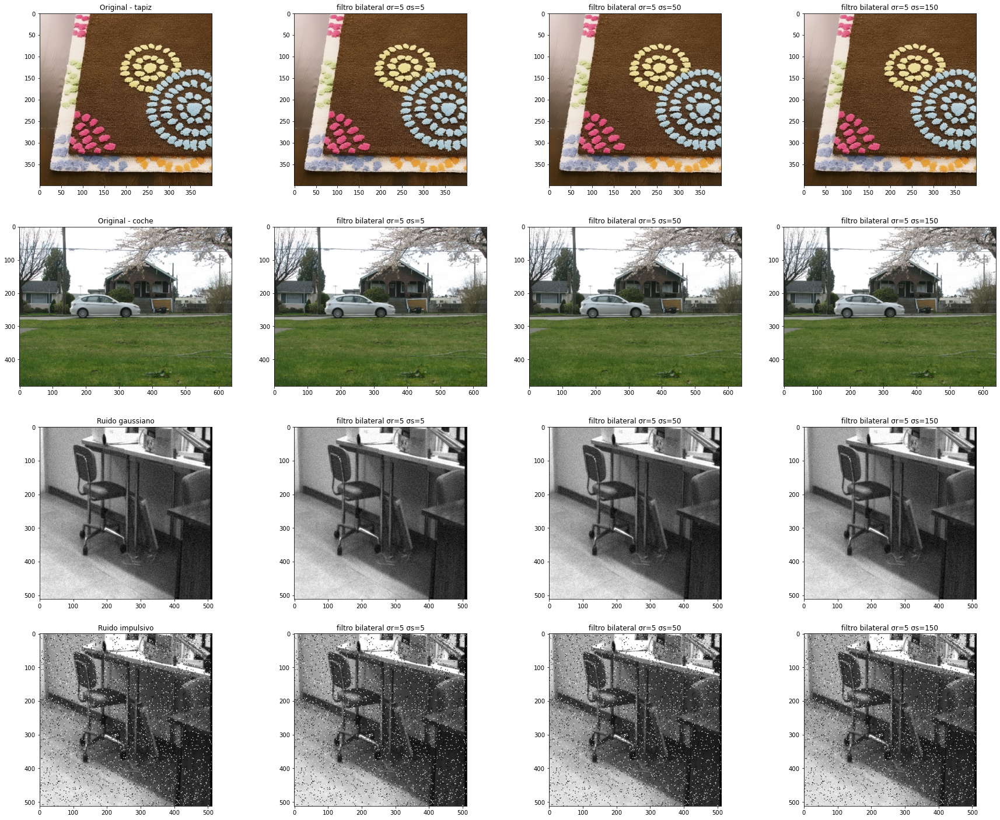

In [34]:
# Para valores no positivos en el parámetro d, diámetro de vecindad, éste se
# calcula proporcionalmente a sigma_s, pero hacer esto ralentiza muchísimo el 
# proceso cuando sigma_s es alto. Vamos a usarlo en cualquier caso, ya que sino
# el parámetro sigma_s pierde su utilidad al hacer referencia también a la distancia
# a la que los pixeles se influencian entre ellos
d = -1
sigma_r = 5
sigma_s = 5
photo41 = cv2.bilateralFilter(originalTapiz,d,sigma_r,sigma_s)
photo42 = cv2.bilateralFilter(originalCar,d,sigma_r,sigma_s)
photo43 = cv2.bilateralFilter(original1,d,sigma_r,sigma_s)
photo44 = cv2.bilateralFilter(original2,d,sigma_r,sigma_s)

sigma_s = 50
photo45 = cv2.bilateralFilter(originalTapiz,d,sigma_r,sigma_s)
photo46 = cv2.bilateralFilter(originalCar,d,sigma_r,sigma_s)
photo47 = cv2.bilateralFilter(original1,d,sigma_r,sigma_s)
photo48 = cv2.bilateralFilter(original2,d,sigma_r,sigma_s)

sigma_s = 150
photo49 = cv2.bilateralFilter(originalTapiz,d,sigma_r,sigma_s)
photo50 = cv2.bilateralFilter(originalCar,d,sigma_r,sigma_s)
photo51 = cv2.bilateralFilter(original1,d,sigma_r,sigma_s)
photo52 = cv2.bilateralFilter(original2,d,sigma_r,sigma_s)

f, axs = plt.subplots(4, 4, figsize=(30,25))
axs[0,0].set_title('Original - tapiz')
axs[0,0].imshow(originalTapiz)
axs[0,1].set_title('filtro bilateral σr=5 σs=5')
axs[0,1].imshow(photo41)
axs[0,2].set_title('filtro bilateral σr=5 σs=50')
axs[0,2].imshow(photo45)
axs[0,3].set_title('filtro bilateral σr=5 σs=150')
axs[0,3].imshow(photo49)
axs[1,0].set_title('Original - coche')
axs[1,0].imshow(originalCar)
axs[1,1].set_title('filtro bilateral σr=5 σs=5')
axs[1,1].imshow(photo42)
axs[1,2].set_title('filtro bilateral σr=5 σs=50')
axs[1,2].imshow(photo46)
axs[1,3].set_title('filtro bilateral σr=5 σs=150')
axs[1,3].imshow(photo50)
axs[2,0].set_title('Ruido gaussiano')
axs[2,0].imshow(original1,cmap='gray')
axs[2,1].set_title('filtro bilateral σr=5 σs=5')
axs[2,1].imshow(photo43,cmap='gray')
axs[2,2].set_title('filtro bilateral σr=5 σs=50')
axs[2,2].imshow(photo47,cmap='gray')
axs[2,3].set_title('filtro bilateral σr=5 σs=150')
axs[2,3].imshow(photo51,cmap='gray')
axs[3,0].set_title('Ruido impulsivo')
axs[3,0].imshow(original2,cmap='gray')
axs[3,1].set_title('filtro bilateral σr=5 σs=5')
axs[3,1].imshow(photo44,cmap='gray')
axs[3,2].set_title('filtro bilateral σr=5 σs=50')
axs[3,2].imshow(photo48,cmap='gray')
axs[3,3].set_title('filtro bilateral σr=5 σs=150')
axs[3,3].imshow(photo52,cmap='gray')

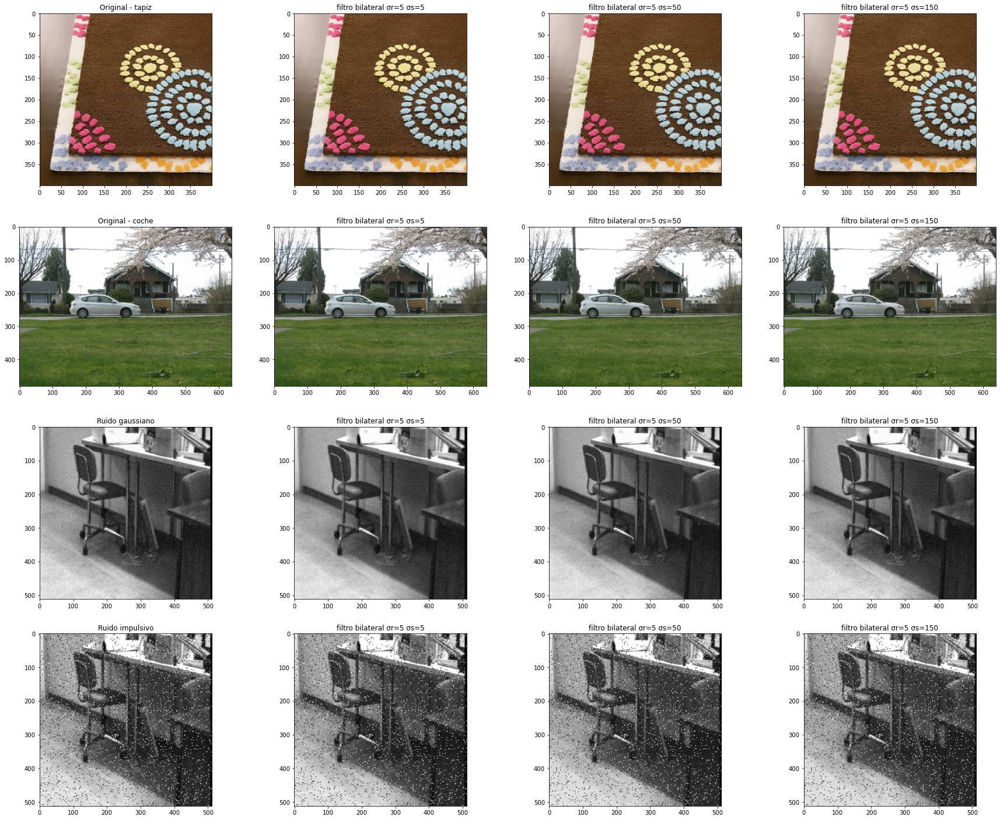

In [35]:
# Para valores no positivos en el parámetro d, diámetro de vecindad, éste se
# calcula proporcionalmente a sigma_s, pero hacer esto ralentiza muchísimo el 
# proceso cuando sigma_s es alto. Vamos a usarlo en cualquier caso, ya que sino
# el parámetro sigma_s pierde su utilidad al hacer referencia también a la distancia
# a la que los pixeles se influencian entre ellos
d = -1
sigma_r = 10
sigma_s = 5
photo41 = cv2.bilateralFilter(originalTapiz,d,sigma_r,sigma_s)
photo42 = cv2.bilateralFilter(originalCar,d,sigma_r,sigma_s)
photo43 = cv2.bilateralFilter(original1,d,sigma_r,sigma_s)
photo44 = cv2.bilateralFilter(original2,d,sigma_r,sigma_s)

sigma_s = 50
photo45 = cv2.bilateralFilter(originalTapiz,d,sigma_r,sigma_s)
photo46 = cv2.bilateralFilter(originalCar,d,sigma_r,sigma_s)
photo47 = cv2.bilateralFilter(original1,d,sigma_r,sigma_s)
photo48 = cv2.bilateralFilter(original2,d,sigma_r,sigma_s)

sigma_s = 150
photo49 = cv2.bilateralFilter(originalTapiz,d,sigma_r,sigma_s)
photo50 = cv2.bilateralFilter(originalCar,d,sigma_r,sigma_s)
photo51 = cv2.bilateralFilter(original1,d,sigma_r,sigma_s)
photo52 = cv2.bilateralFilter(original2,d,sigma_r,sigma_s)

f, axs = plt.subplots(4, 4, figsize=(30,25))
axs[0,0].set_title('Original - tapiz')
axs[0,0].imshow(originalTapiz)
axs[0,1].set_title('filtro bilateral σr=5 σs=5')
axs[0,1].imshow(photo41)
axs[0,2].set_title('filtro bilateral σr=5 σs=50')
axs[0,2].imshow(photo45)
axs[0,3].set_title('filtro bilateral σr=5 σs=150')
axs[0,3].imshow(photo49)
axs[1,0].set_title('Original - coche')
axs[1,0].imshow(originalCar)
axs[1,1].set_title('filtro bilateral σr=5 σs=5')
axs[1,1].imshow(photo42)
axs[1,2].set_title('filtro bilateral σr=5 σs=50')
axs[1,2].imshow(photo46)
axs[1,3].set_title('filtro bilateral σr=5 σs=150')
axs[1,3].imshow(photo50)
axs[2,0].set_title('Ruido gaussiano')
axs[2,0].imshow(original1,cmap='gray')
axs[2,1].set_title('filtro bilateral σr=5 σs=5')
axs[2,1].imshow(photo43,cmap='gray')
axs[2,2].set_title('filtro bilateral σr=5 σs=50')
axs[2,2].imshow(photo47,cmap='gray')
axs[2,3].set_title('filtro bilateral σr=5 σs=150')
axs[2,3].imshow(photo51,cmap='gray')
axs[3,0].set_title('Ruido impulsivo')
axs[3,0].imshow(original2,cmap='gray')
axs[3,1].set_title('filtro bilateral σr=5 σs=5')
axs[3,1].imshow(photo44,cmap='gray')
axs[3,2].set_title('filtro bilateral σr=5 σs=50')
axs[3,2].imshow(photo48,cmap='gray')
axs[3,3].set_title('filtro bilateral σr=5 σs=150')
axs[3,3].imshow(photo52,cmap='gray')

#### Resultados con $\sigma_r$ baja

En este caso, al ser este parámetro muy bajo, se va a limitar mucho el efecto de los pixeles vecinos en el valor de cada pixel de la imagen puesto que queda muy reducido el margen, la diferencia de valor, que pueden tener pixeles de una vecindad para afectarse entre sí.

En este caso, con un valor muy bajo de $\sigma_r=5$, lo que ocurre es muy simple. El filtro no funciona y no suaviza la imagen, no elimina ningún tipo de ruido y no tiene prácticamente ningún efecto, para cualquier valor de $\sigma_s$.

Hemos probado también con  $\sigma_r=10$ para comprobar si se notaba el filtrado, pero ocurre lo mismo que con  $\sigma_r=5$. Hemos decidido no hacer más comprobaciones guiándonos por las especificaciones de la función, ya que se especifica el funcionamiento del filtro para valores bajos y altos, estableciendo los altos en $\sigma_r>100$ y los bajos en $\sigma_r<10$.

#### Resultados respecto al filtro gaussiano

Comparando los resultados con los del filtro gaussiano, se pueden sacar algunas conclusiones. 

Para filtrar el ruido gaussiano, ambos funcionan razonablemente bien. Sin embargo hay que matizar que el filtro gaussiano suaviza toda la imagen incluyendo los bordes, lo que afecta a las propiedades de la imagen en mayor medida que el filtro bilateral, que no afecta tanto a los bordes. Por tanto, para filtrar el ruido gaussiano alterando lo mínimo la imagen es mejor el filtro bilateral. El filtrado bilateral tiene una componente en el filtrado que fija las diferencias en los valores, es decir, las diferencias en los colores a filtrar. Y es esa parte del filtro la que le permite mantener los bordes de la imagen poco alterados, ya que se puede jugar con este parámetro para buscar un valor lo suficientemente alto como para eliminar el ruido, pero al mismo tiempo lo suficientemente bajo como para evitar suavizar demasiado los bordes y evitar, como hemos visto antes, que las regiones cercanas con distintas intensidades y colores se contaminen entre sí.

Por otro lado, es cierto que el filtrado gaussiano es bastante más rápido que el bilateral, lo que es un punto a favor del primero en caso de que la rapidez sea necesaria. 

En cuanto al ruido impulsivo, no se puede decir mucho más aparte de que ninguno es capaz de eliminarlo de la imagen.

# Transformada de Hough

## **Ejercicio 5.** 
Utiliza la función ``cv2.HoughLines()`` de OpenCV para encontrar líneas en la imagen ``telefonica.jpg`` y ``urjc.jpg``. Para extraer los bordes de la imagen utiliza las funciones escritas más arriba. 

Discute cómo  has realizado la conversión de RGB a niveles de gris, el funcionamiento para distintos valores de los parámetros de la función, así como de
los filtros utilizados para extraer los bordes de la imagen. Pinta los resultados sobre la imagen (te proporcionamos algo de código por si fuese útil).

In [9]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

def draw_lines(img, lines, color=(0, 0, 255), thickness=2):
    """
    Draws a set of lines detected using the OpenCV Hough transform
    :param img: An input image in BGR format of type np.int8
    :param lines: List or Numpy array containing the parameters of the homogeneous line as: ax + by + c = 0
    :param color: The color used to draw the lines. Red by default.
    :param thickness: The thickness of the lines to be drawn
    """
    if lines is not None:
        for i in range(len(lines)):
            eq = lines[i]
            rho = -eq[2]
            a = eq[0]
            b = eq[1]
            x0 = a * rho
            y0 = b * rho
            x1 = int(x0 - 4500 * b)
            y1 = int(y0 + 4500 * a)
            x2 = int(x0 + 4500 * b)
            y2 = int(y0 - 4500 * a)

            cv2.line(img, (x1, y1), (x2, y2), color, thickness)

def gaussed(img, sigma, gaussianT):
  n = 3
  gray_original = cv2.imread(img, cv2.IMREAD_GRAYSCALE)
  gaussianMasc = masc_gaus(sigma,n)
  gaussianDer = masc_deriv_gaus(sigma, n)
  auxV =scipy.ndimage.convolve1d(gray_original, gaussianMasc, axis=1)
  auxV =scipy.ndimage.convolve1d(auxV, gaussianDer, axis=0)
  auxH =scipy.ndimage.convolve1d(gray_original, gaussianMasc, axis=0)
  auxH =scipy.ndimage.convolve1d(auxH, gaussianDer, axis=1)
  photoGaussed = auxV + auxH
  ret,thresh1 = cv2.threshold(photoGaussed,gaussianT,255,cv2.THRESH_BINARY)
  return thresh1
  
def getHough(url, imageBorder, threshold):
  img = cv2.imread(url)
  lineasimg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  lines = np.squeeze(cv2.HoughLines(imageBorder,1,np.pi/180,threshold))

  try:
    # Convert the lines to homogeneous coordinates
    lines = np.array([np.cos(lines[:, 1]), np.sin(lines[:, 1]), -lines[:, 0]]).T
    # Draw andshow the lines
    draw_lines(lineasimg, lines)
  except:
    lineasimg=lineasimg

  return lineasimg

def plotHough(url,gaussianT):
  for sigma in [4,5,6,8,10,12]:
    imageBorder = gaussed(url, sigma, gaussianT)
    f, axs = plt.subplots(1, 8, figsize=(40,40))
    axs[0].set_title('Original - Telefonica sigma:' + str(sigma))
    axs[0].imshow(imageBorder, cmap='gray')
    a=1
    for threshold in [100,150,200,250,300,350,400]:
      imageProcessed = getHough(url,imageBorder,threshold)
      axs[a].set_title('Sigma:' + str(sigma) +" ThresholdHough:" + str(threshold))
      axs[a].imshow(imageProcessed)
      a += 1
    plt.show()

### Conversión de RGB a niveles de gris

Para la obtencion de lineas usando la transformada de Hough es necesario comenzar realizando una conversion de la imagen que queremos analizar y pasarla a escala de grises. Para lograrlo nos valemos de una funcion que nos facilita opencv, usando su funcion `cv.imread()` y usando `cv.IMREAD_GRAYSCALE` como segundo parametro.

### Filtros utilizados para extraer los bordes de la imagen
 
Una vez obtenemos la imagen en escala de grises hemos usando el filtro de la derivada del gaussiano que hemos desarrollado en apartados anteriores ya que nos sirve para obtener los resultados. Hemos optado por usar este filtro con n=3, es decir, una mascara de tamaño 3. ¿Por que hemos decidido usar este tamaño? Porque computacionalmanete es mas ligera que tamaños mas grandes, pero devuelve resultados bastante correctos. En cuanto a sigma, hemos decidido usar distintos valores para ver como variaban los resultados de la transformada.

### Funcionamiento para distintos valores de los parámetros de la función

Primero de todo analicemos un poco de que variables depende el resultado de la función `cv2.HoughLines(dst,lines,rho,theta,thershold)`:

*  **dst**: Imagen con los bordes. Tiene que ser una imagen en escala de .
*  **lines**: Un vector donde se guarda los parametros(r,θ) de las lineas detectadas.
*  **rho**: La resolucion del parametro r en pixeles, nosotros hemos usado 1 y no lo hemos modificado.
*  **theta**: La resolucion del parametro θ en radianes, nosotros hemos usado 1 grado (`CV_PI/180`) y no lo hemos modificado.
*  **threshold**: El numero minimo de intersecciones para contemplar una linea como tal. Este parametro es con el que hemos querido y tenido que jugar para conseguir resultados ajustados a lo que necesitabamos en cada caso.

### Funcionamiento al analizar imagenes

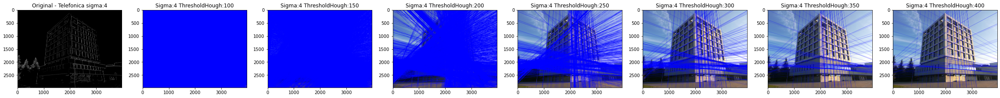

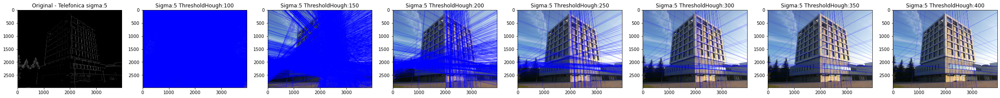

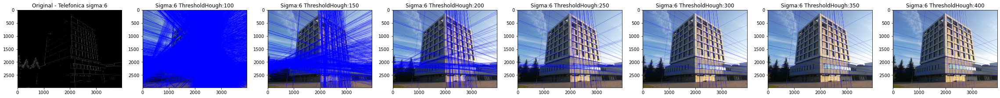

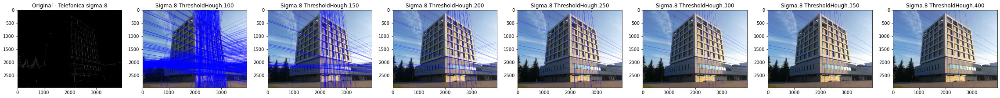

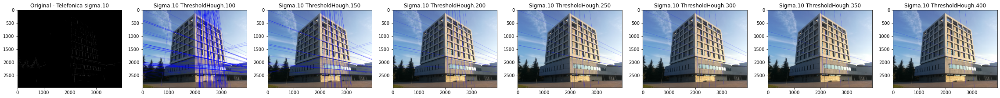

...

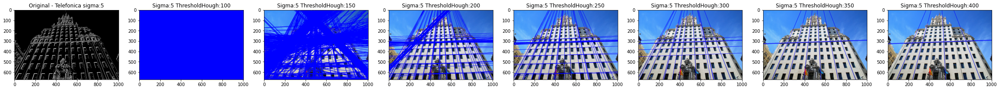

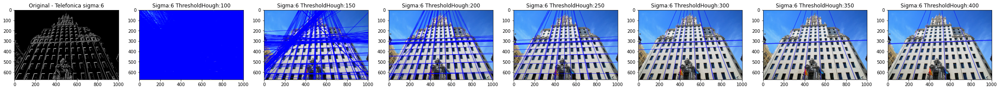

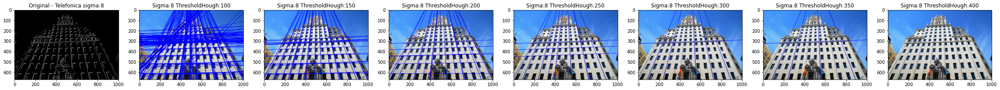

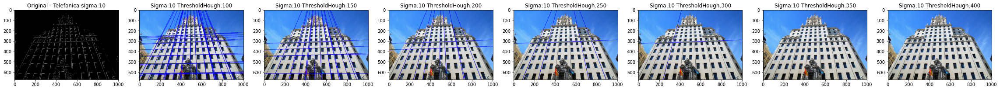

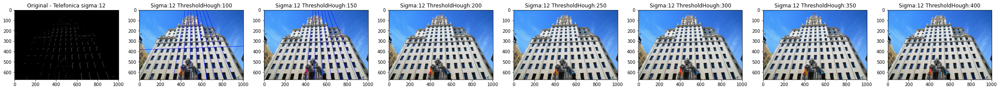

In [10]:
telefonicapath = "./imagenes/telefonica.jpg"
urjcpath = "./imagenes/urjc.jpg"
plotHough(urjcpath,80)
plotHough(telefonicapath,100)

### Obtencion de lineas dependiendo del tamaño de la imagen o del tamaño de las lineas.

En lo que a la obtencion final de lineas respecta, es importante el tamaño de la imagen o el numero minimo de puntos(pixeles) por el que la recta tiene que pasar para considerarlo una linea. 

---

#### urjc.jpg
En el caso de la imagen `urjc.jpg`, la cual tiene un tamaño de unos 4000x3000 pixeles necesitamos que el threshold tenga un tamaño de entre unos 300 y 450 puntos para conseguir las lineas que forman tanto la parte sobreada como la parte mejor iluminada, ademas de intentando eliminar el ruido provocado por los arboles ya que forzamos a que esta lineas tengan que ser largas.

Nos quedariamos con Figura(Sigma:4 Threshold:400)

---

#### telefonica.jpg
Por otro lado, si nos fijamos en la imagen `telefonica.jpg`, podemos observar que es necesario que este threshold sea muchisimo mas bajo. Está, tiene un tamaño de unos 4000x3000 pixeles necesitamos que el threshold tenga un tamaño de entre unos 100 y 150 puntos para conseguir las lineas que forman las ventanas tanto horizontal como vertical. Esto combinado con un sigma alto, nos permite obtener unas lineas que se ajustan a lo que queremos.

Nos quedariamos conFigura(Sigma:8 Threshold:150) o Figura(Sigma:10 Threshold:150)

---

#### Debemos ajustarnos a las propiedades de la imagen y al resultado deseado

Como hemos observado, para una imagen unos valores son perfectos para obtener el resultado deseado, pero para la otra no sirve y se aleja muchisimo de lo que queremos obtener.

Por ejemplo si a la imagen `telefonica.jpg` le aplicamos los parametros que hemos decidido como correctos para `urjc.jpg`(Sigma:4 Threshold:400) nos devuelve 4 o 5 lineas verticales y una horizontal. Este resultado se aleja mucho del optimo que conseguimos con los parametros ajustados a las propiedades de esta imagen. 


# Segmentación

In [18]:
!pip install pygame
!pip install PyMaxflow

import pygame
import numpy as np
import cv2
import maxflow
import matplotlib.pyplot as plt
import os
from math import sqrt

## **Ejercicio 6.** 
Escribe una función que segmente el objeto central de una imagen a partir de una segmentación manual inicial realizada por el usuario. 

Puedes utilizar, a modo de ejemplo, el código proporcionado en el archivo ``segm.py``. El archivo ``select_pixels.py`` contiene código para pintar sobre la imagen.

En esta primera versión 
1. toma como afinidad entre una pareja de píxeles la diferencia en sus valores de color y;
2. sólo establece los términos unitarios de los píxeles marcados por el usuario.

Aplícalo al menos a la imagen ``horse.jpg`` aunque también debes intentar segmentar  ``flower.png``, ``persona.png``, ``car.jpg`` y ``mit2.png``, que son progresivamente más complejas. Muestra y discute los resultados. Justifica los errores. En el ejercicio siguiente tendrás la oportunidad de mejorar tu algoritmo para que pueda resolver casos más difíciles.

In [12]:
def roundline(srf, color, start, end, radius=1):
    dx = end[0]-start[0]
    dy = end[1]-start[1]
    distance = max(abs(dx), abs(dy))
    for i in range(distance):
        x = int( start[0]+float(i)/distance*dx)
        y = int( start[1]+float(i)/distance*dy)
        pygame.draw.circle(srf, color, (x, y), radius)

def select_fg_bg(img, radio=2):
    """ Shows image img on a window and lets you mark in red, green and blue 
        pixels in the image.
        img: numpy array with the image to be labeled
        radio: is the radio of the circumference used as brush
        returns: a numpy array that is the image painted
    """
    # Creates the screen where the image will be displayed
    # Shapes are reversed in img and pygame screen
    screen = pygame.display.set_mode(img.shape[-2::-1])

#    imgpyg=pygame.image.load(imgName)
    imgpyg=pygame.image.frombuffer(img,img.shape[-2::-1],'RGB')
    screen.blit(imgpyg,(0,0))
    pygame.display.flip() # update the display

    draw_on = False
    last_pos = (0, 0)
    color_red = (255, 0, 0)
    color_green = (0,255,0)
    color_blue = (0,0,255)

    while True:
        e = pygame.event.wait()
        if e.type == pygame.QUIT:
            break;
        if e.type == pygame.MOUSEBUTTONDOWN:
            if pygame.mouse.get_pressed()[0]:
                color=color_red
            elif pygame.mouse.get_pressed()[2]:
                color=color_green
            else:
                color=color_blue
            pygame.draw.circle(screen, color, e.pos, radio)
            draw_on = True
        if e.type == pygame.MOUSEBUTTONUP:
            draw_on = False
        if e.type == pygame.MOUSEMOTION:
            if draw_on:
                pygame.draw.circle(screen, color, e.pos, radio)
                roundline(screen, color, e.pos, last_pos,  radio)
            last_pos = e.pos
        pygame.display.flip()

    imgOut=np.ndarray(shape=img.shape[:2]+(4,),dtype='u1',buffer=screen.get_buffer().raw)
    pygame.quit()

    return(cv2.cvtColor(imgOut[:,:,:3],cv2.COLOR_BGR2RGB))

# Función para calcular distancia euclídea entre dos tripletas, que valdría tanto para
# el espacio de colores RGB, como para BGR o cualquiera tridimensional realmente.
def eucDist(c2,c1):
    R2,G2,B2 = c2
    R1,G1,B1 = c1
    return sqrt( (R2-R1)**2 + (G2-G1)**2 + (B2-B1)**2 )

# Función implementada por el usuario de github fikr4n en 
# https://gist.github.com/fikr4n/368f2f2070e0f9a15fb4 para el cálculo de la distancia entre
# colores en base a la definición CIE94
def _square(x):
    return x * x

def cie94(L1_a1_b1, L2_a2_b2):
    """Calculate color difference by using CIE94 formulae
    
    See http://en.wikipedia.org/wiki/Color_difference or
    http://www.brucelindbloom.com/index.html?Eqn_DeltaE_CIE94.html.
    
    cie94(rgb2lab((255, 255, 255)), rgb2lab((0, 0, 0)))
    >>> 58.0
    cie94(rgb2lab(rgb(0xff0000)), rgb2lab(rgb('#ff0000')))
    >>> 0.0
    """
    
    L1, a1, b1 = L1_a1_b1
    L2, a2, b2 = L2_a2_b2

    C1 = sqrt(_square(a1) + _square(b1))
    C2 = sqrt(_square(a2) + _square(b2))
    delta_L = L1 - L2
    delta_C = C1 - C2
    delta_a = a1 - a2
    delta_b = b1 - b2
    delta_H_square = _square(delta_a) + _square(delta_b) - _square(delta_C)
    return (sqrt(_square(delta_L)
            + _square(delta_C) / _square(1.0 + 0.045 * C1)
            + delta_H_square / _square(1.0 + 0.015 * C1)))

### Funciones utilizadas 
Además de las funciones de ayuda proporcionadas para la práctica, algunas más, una sacada de github y otras propias, para el cálculo de la diferencia entre pixeles vecinos. Lo que mejor resultados ha dado ha sido utilizar para las matrices de pesos de pixeles vecinos:
* La distancia en el ángulo h (rueda de colores) del espacio HSV
* La diferencia en el espacio de la escala de grises
* La distancia CIE94
* La distancia euclidea en el espacio RGB (o BGR)


* Aplicando después una exponencial a la matrices cambiadas de signo obtenidas con cualquiera de esos tres métodos. Los resultados en los tres casos son muy similares ya que dan lugar a matrices de pesos muy parecidas.

En la siguiente celda están cada uno de los 4 métodos que se han probados. Comentar que el principal problema, y la razón de haber probado tantos métodos, es que no caímos en aplicar esta exponencial a las matrices cambiadas de signo, que es precisamente lo que provoca el cambio entre unos resultados muy pobre en los que la segmentación es completamente incorrecta, y unos resultados razonablemente buenos para las imágenes sencillas. 

El caso de utilizar el ángulo en el espacio HSV no da resultados adecuados con la imagen más sencilla tanto con exponencial como sin ella, aunque es altamente probable, teniendo en cuenta el resto de casos, que utilizando la distancia euclidea de los tres valores de este espacio en lugar de solo el ángulo esto cambie. Sin embargo, este método para la afinidad sí que da mejores resultados para otras imágenes, como la de la flor, quizás debido a que permite obtener los bordes en las matrices de los pesos de los vecinos, lo cual es bastante curioso.

In [13]:
## Calculo de afinidad entre pixeles mediante diferencia de ángulo en el espacio HSV
# Nota: parece que tiene cierta utilidad para encontrar bordes de la imagen
def hueHSVNeighbDistance(img):
    # Calcula los costes de los nodos no terminales del grafo
    # En esta versión, se calcula como la diferencia entre valores de pixeles vecinos
    # Para ello, una forma que hemos visto como recomendada por el foro de OpenCV
    # consiste en utilizar la rueda HSV (hue, saturation, value) como representación
    # de los colores, y coger el ángulo (hue) en la rueda de colores para calcular las 
    # diferencias entre pixeles vecinos. 

    # Se ha escogido este método después de buscar formas de hacerlo, y de ver que en ese 
    # foro se comenta que funciona bastante bien para segmentación. Existen estándares 
    # como CIE94 o CIELAB, pero para segmentación de objetos comentan que no es necesario

    # Nota: es el que peor resultados termina dado al aplicar la exponencial a las matrices de pesos

    # Cambiamos el espacio de colores a HSV y extraemos dos dimensiones de la resolución 
    # de la imagen
    imgHSV = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    rows = img.shape[0]
    cols = img.shape[1]

    # Nos quedamos con la primera componente de cada pixel, el ángulo en la ruleta de colores.
    # Hacemos un casting a float porque sino, al calcular diferencias entre angulos puede
    # haber desbordamiento
    h_values = imgHSV[:,:,0].astype(np.float)

    # Estos son los costes de los vecinos horizontales
    exp_aff_h=np.zeros(img.shape[:2])
    exp_aff_h[:,1:] = abs(h_values[:,1:] - h_values[:,:cols-1])
    # En este espacio de color, el ángulo varía entre 0 y 180º en lugar de llegar a 360º
    # Hay que corregir los valores si cruzan los 0º
    # Entre 10º y 170º hay 160 de diferencia, pero al ser 180 equivalente a 0º, deben ser 20º
    for x in range(0,exp_aff_h.shape[0]):
        for y in range(1,exp_aff_h.shape[1]):
            exp_aff_h[x,y] = min( exp_aff_h[x,y], 180 - exp_aff_h[x,y] )

    # Estos son los costes de los vecinos verticales
    # Adaptamos el método usado para los horizontales
    exp_aff_v=np.zeros(img.shape[:2])
    exp_aff_v[1:,:] = abs(h_values[1:,:] - h_values[:rows-1,:])
    for x in range(1,exp_aff_v.shape[0]):
        for y in range(0,exp_aff_v.shape[1]):
            exp_aff_v[x,y] = min( exp_aff_v[x,y], 180 - exp_aff_v[x,y] ) 
    
    # Aplicamos exponencia a la matriz cambiada de signo, de forma que se acentue la diferencia
    # entre regiones de la imagen    
    exp_aff_h = np.exp(-exp_aff_h)
    exp_aff_v = np.exp(-exp_aff_v)
    
    return exp_aff_h, exp_aff_v


## Calculo de afinidad entre pixeles mediante diferencia en el nivel de gris (luminancia)
def grayNeighbDistance(img):
    # Para ello, cambiamos al espacio de color de escala de grises, y las diferencias podrán 
    # obtenerse directamente restando los valores de los vecinos
    imgGray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # Hacemos un casting a float porque sino, al calcular diferencias entre escala de grises
    # puede haber desbordamiento
    g_values = imgGray[:,:].astype(np.float)

    # Estos son los costes de los vecinos horizontales
    exp_aff_h=np.zeros(img.shape[:2])
    for x in range(0,exp_aff_h.shape[0]):
        for y in range(1,exp_aff_h.shape[1]):
            exp_aff_h[x,y] = abs(g_values[x,y]-g_values[x,y-1])

    # Estos son los costes de los vecinos verticales
    exp_aff_v=np.zeros(img.shape[:2])
    for x in range(1,exp_aff_v.shape[0]):
        for y in range(0,exp_aff_v.shape[1]):
            exp_aff_v[x,y] = abs(g_values[x,y]-g_values[x-1,y])
        
    # Aplicamos exponencia a la matriz cambiada de signo, de forma que se acentue la diferencia
    # entre regiones de la imagen    
    exp_aff_h = np.exp(-exp_aff_h)
    exp_aff_v = np.exp(-exp_aff_v)
    
    return exp_aff_h, exp_aff_v


## Calculo afinidad mediante la diferencia entre dos colores RGB con cie94 
def cie94NeighbDistance(img):
    imgLab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    # Hacemos un casting a float para evitar desbordamiento
    l_values = imgLab[:,:,:].astype(np.float)

    # Estos son los costes de los vecinos horizontales
    exp_aff_h=np.zeros(img.shape[:2])
    for x in range(0,exp_aff_h.shape[0]):
        for y in range(1,exp_aff_h.shape[1]):
            exp_aff_h[x,y] = cie94(l_values[x,y],l_values[x,y-1])

    # Estos son los costes de los vecinos verticales
    exp_aff_v=np.zeros(img.shape[:2])
    for x in range(1,exp_aff_v.shape[0]):
        for y in range(0,exp_aff_v.shape[1]):
            exp_aff_v[x,y] = cie94(l_values[x,y],l_values[x-1,y])
        
    # Aplicamos exponencia a la matriz cambiada de signo, de forma que se acentue la diferencia
    # entre regiones de la imagen    
    exp_aff_h = np.exp(-exp_aff_h)
    exp_aff_v = np.exp(-exp_aff_v)
    
    return exp_aff_h, exp_aff_v


## Cálculo de la diferencia mediante distancia euclídea entre píxeles BGR
def euclideanNeighbTripletDistance(img):
    # Dado que en el caso de los anteriores los resultados han sido realmente malos, 
    # vamos a hacer un último intento con este otro tipo de medida para la distancia

    # Hacemos un casting a int16 para evitar desbordamiento
    rgb_values = img[:,:,:].astype(np.int16)

    # Estos son los costes de los vecinos horizontales
    exp_aff_h=np.zeros(img.shape[:2])
    for x in range(0,exp_aff_h.shape[0]):
        for y in range(1,exp_aff_h.shape[1]):
            exp_aff_h[x,y] = eucDist(rgb_values[x,y], rgb_values[x,y-1])

    # Estos son los costes de los vecinos verticales
    exp_aff_v=np.zeros(img.shape[:2])
    for x in range(1,exp_aff_v.shape[0]):
        for y in range(0,exp_aff_v.shape[1]):
            exp_aff_v[x,y] = eucDist(rgb_values[x,y], rgb_values[x-1,y])
        
    # Aplicamos exponencia a la matriz cambiada de signo, de forma que se acentue la diferencia
    # entre regiones de la imagen    
    exp_aff_h = np.exp(-exp_aff_h)
    exp_aff_v = np.exp(-exp_aff_v)
    
    return exp_aff_h, exp_aff_v

Establecemos también la segmentación como una función, pasándole como parámetros la imagen, la marca del usuario y el modo para el cálculo de la afinidad. Se ha añadido otro verbose para indicar si se quiere que se impriman las matrices de vecinos y la segmentación.

In [14]:
# Establecemos la segmentación como una función que aplica la segmentación a una imagen img 
# dada una imagen marcada por el usuario markedImg y con un cálculo de la afinidad entre
# vecinos mediante la distancia entre pixeles según un modo:
# ndmode = 0 -> costes mediante diferencia en el ángulo en el espacio HSV
# ndmode = 1 -> costes mediante diferencia en el nivel de gris
# ndmode = 2 -> costes mediante el método cie94 en el espacio LAB
# ndmode = 3 -> costes mediante distancia euclidea entre tripleta RGB (u otro espacio de colores con 3 dimensiones)
# verbose = 1 -> imprimir las imágenes de la segmentación y las matrices de vecinos

def interactiveSegmentation(img,markedImg,ndmode,verbose):
# Create the graph.
    g = maxflow.Graph[float]()

    # Add the nodes. nodeids has the identifiers of the nodes in the grid.
    nodeids = g.add_grid_nodes(img.shape[:2])

    ################################################################################################################
    modo = ''
    
    if ndmode==0:
        exp_aff_h, exp_aff_v = hueHSVNeighbDistance(img)
        modo = "ángulo en espacio HSV"
    elif ndmode==1:
        exp_aff_h, exp_aff_v = grayNeighbDistance(img)
        modo = "diferencia de nivel de gris"
    elif ndmode==2:
        exp_aff_h, exp_aff_v = cie94NeighbDistance(img)
        modo = "cie94"
    elif ndmode==3:
        exp_aff_h, exp_aff_v = euclideanNeighbTripletDistance(img)
        modo = "distancia euclidea RGB"
    ################################################################################################################

    # Construyo el grafo 
    # Para construir el grafo relleno las estructuras
    hor_struc=np.array([[0, 0, 0],
                        [1, 0, 0],
                        [0, 0, 0]])

    ver_struc=np.array([[0, 1, 0],
                        [0, 0, 0],
                        [0, 0, 0]])
    # Construyo el grafo 
    g.add_grid_edges(nodeids, exp_aff_h, hor_struc,symmetric=True)
    g.add_grid_edges(nodeids, exp_aff_v, ver_struc,symmetric=True)

    # Leo los pixeles etiquetados
    # Los marcados en rojo representan el objeto
    pts_fg = np.transpose(np.where(np.all(np.equal(markedImg,(255,0,0)),2)))
    # Los marcados en verde representan el fondo
    pts_bg = np.transpose(np.where(np.all(np.equal(markedImg,(0,255,0)),2)))

    # Incluyo las conexiones a los nodos terminales
    # Pesos de los nodos terminales
    g.add_grid_tedges(nodeids[pts_fg[:,0],pts_fg[:,1]], 1000000, 0)
    g.add_grid_tedges(nodeids[pts_bg[:,0],pts_bg[:,1]], 0, 1000000)

    # Find the maximum flow.
    g.maxflow()
    # Get the segments of the nodes in the grid.
    sgm = g.get_grid_segments(nodeids)
    
    segm = np.uint8(np.logical_not(sgm))
    
    # Lo muestro junto con la imagen para ver el resultado
    wgs=(np.float_(np.logical_not(sgm))+0.3)/1.3
    # Replico los pesos para cada canal y ordeno los indices
    wgs=np.rollaxis(np.tile(wgs,(3,1,1)),0,3)
    segmSuperp = np.uint8(np.multiply(img,wgs))

    if (verbose==1):
        # Muestro las matrices de pesos h y v
        f, axs = plt.subplots(1, 2, figsize=(10,10))
        axs[0].set_title('Matriz de vecinos horizontales')
        axs[0].imshow(exp_aff_h,cmap='gray')
        axs[1].set_title('Matriz de vecinos verticales')
        axs[1].imshow(exp_aff_v,cmap='gray')

        # Muestro el resultado de la segmentacion
        f, axs = plt.subplots(1, 2, figsize=(10,10))
        axs[0].set_title('Segmentación modo {}'.format(modo))
        axs[0].imshow(segm,cmap='gray')
        
        axs[1].set_title('Segmentación superpuesta')
        axs[1].imshow(segmSuperp)
    
    return segm, segmSuperp

Rojo - objeto
Verde - fondo


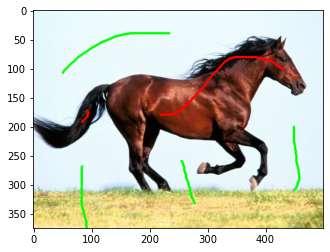

In [16]:
imagen = "imagenes/horse.jpg"
imgBGR = cv2.imread(imagen)
img = cv2.cvtColor(cv2.imread(imagen), cv2.COLOR_BGR2RGB)

plt.imshow(img)
# Marco algunos pixeles que pertenecen el objeto y el fondo
markedImg = select_fg_bg(img)
plt.imshow(markedImg)
print("Rojo - objeto")
print("Verde - fondo")

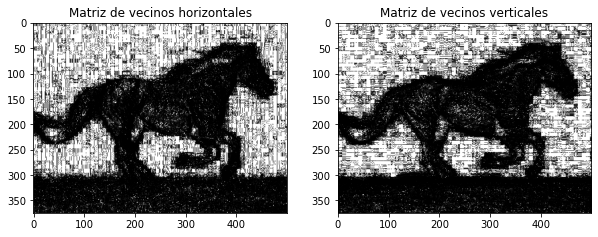

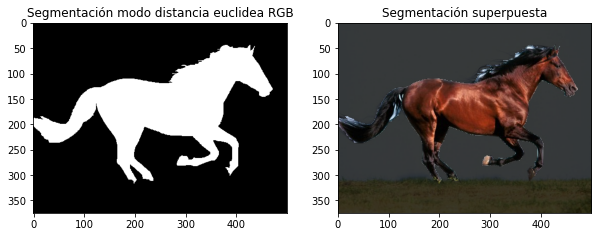

In [19]:
segm, segmSuperp = interactiveSegmentation(img,markedImg,3,1)

### Resultados

Hemos comprobado que para el caso más sencillo, la imagen horse.jpg, el resultado es razonablemente bueno. Sin embargo, para poder comprobar el funcionamiento del algoritmo, vamos ahora a probar con otras imágenes

(180, 272, 3)
(246, 332, 3)
(480, 640, 3)
(100, 100, 3)
Rojo - objeto
Verde - fondo


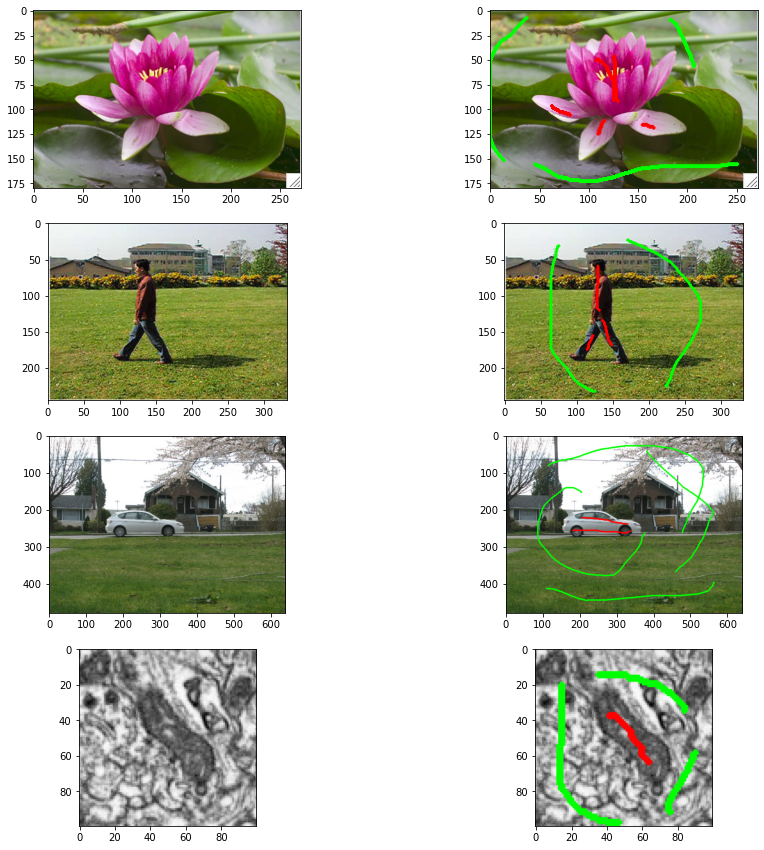

In [20]:
flor = "imagenes/flower.png"
persona = "imagenes/persona.png"
coche = "imagenes/car.jpg"
mit2 = "imagenes/mit2.png"

flor = cv2.cvtColor(cv2.imread(flor), cv2.COLOR_BGR2RGB)
persona = cv2.cvtColor(cv2.imread(persona), cv2.COLOR_BGR2RGB)
coche = cv2.cvtColor(cv2.imread(coche), cv2.COLOR_BGR2RGB)
mit2 = cv2.cvtColor(cv2.imread(mit2), cv2.COLOR_BGR2RGB)

f, axs = plt.subplots(4, 2, figsize=(15,15))
axs[0,0].imshow(flor)
axs[1,0].imshow(persona)
axs[2,0].imshow(coche)
axs[3,0].imshow(mit2)

print(flor.shape)
print(persona.shape)
print(coche.shape)
print(mit2.shape)


# Marco algunos pixeles que pertenecen el objeto y el fondo
markedFlor = select_fg_bg(flor)
markedPersona = select_fg_bg(persona)
markedCoche = select_fg_bg(coche)
markedMit2 = select_fg_bg(mit2)
print("Rojo - objeto")
print("Verde - fondo")

axs[0,1].imshow(markedFlor)
axs[1,1].imshow(markedPersona)
axs[2,1].imshow(markedCoche)
axs[3,1].imshow(markedMit2)

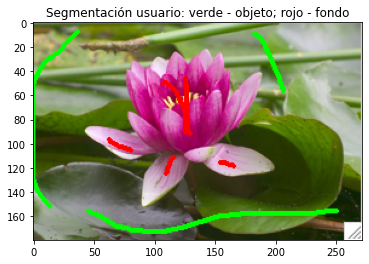

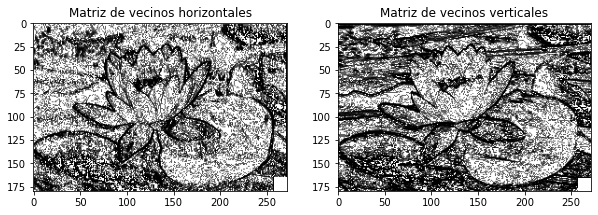

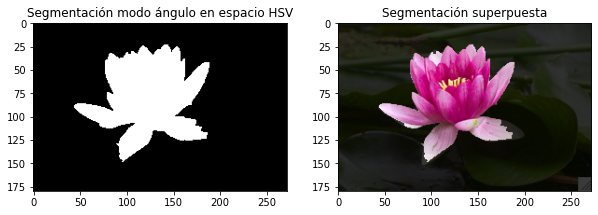

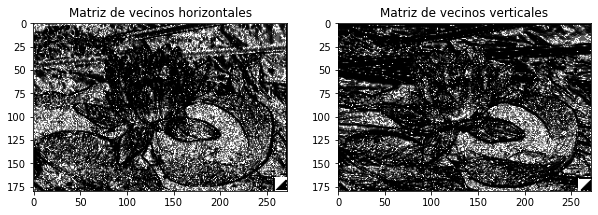

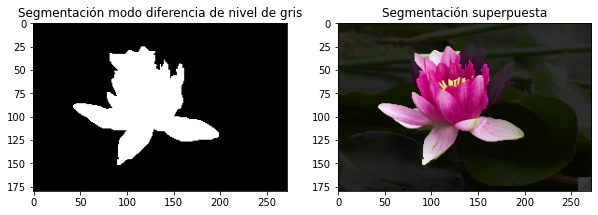

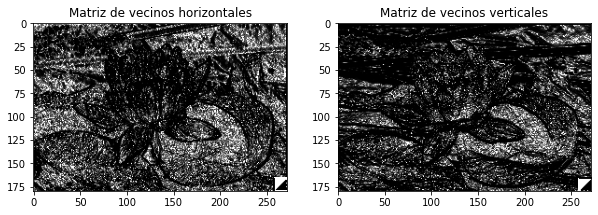

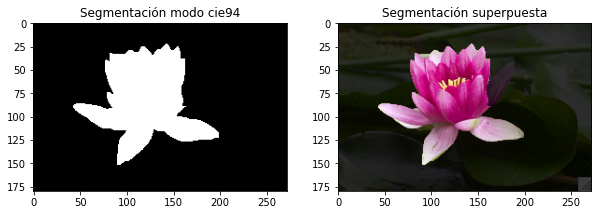

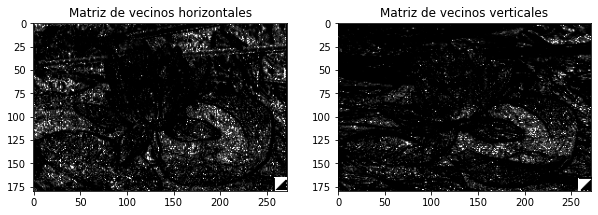

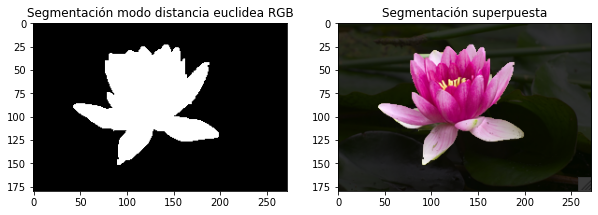

In [21]:
# Muestro la segmentación previa del usuario
plt.figure()
plt.imshow(markedFlor)
plt.title("Segmentación usuario: verde - objeto; rojo - fondo")

a,b = interactiveSegmentation(flor,markedFlor,0,1)
a,b = interactiveSegmentation(flor,markedFlor,1,1)
a,b = interactiveSegmentation(flor,markedFlor,2,1)
a,b = interactiveSegmentation(flor,markedFlor,3,1)

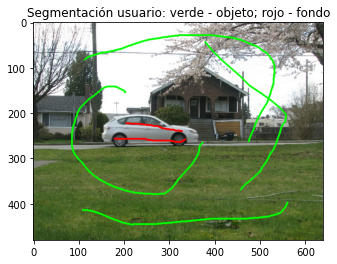

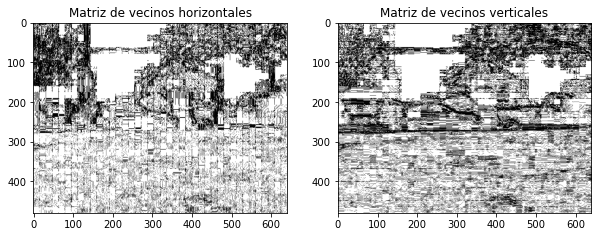

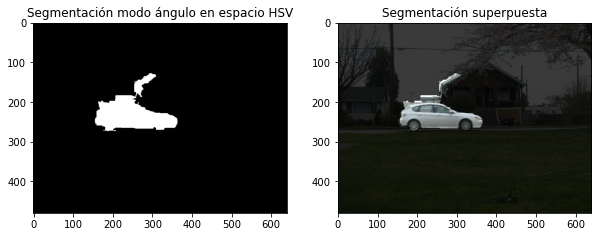

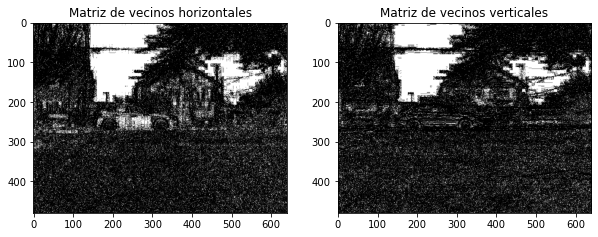

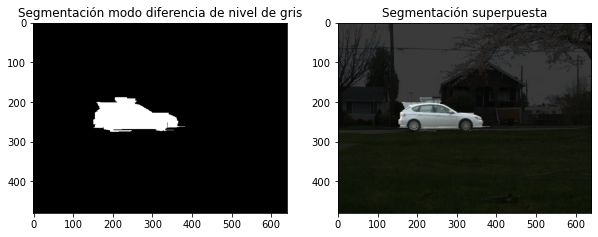

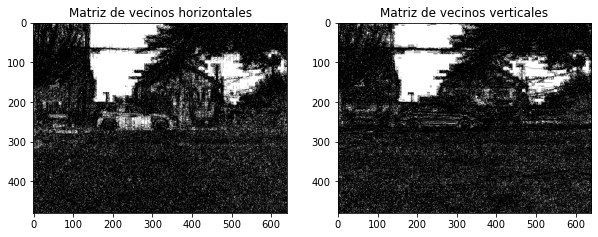

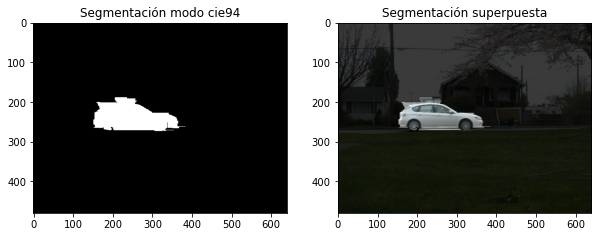

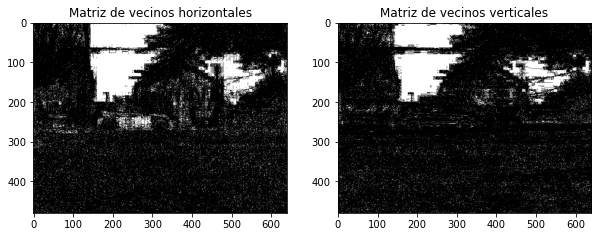

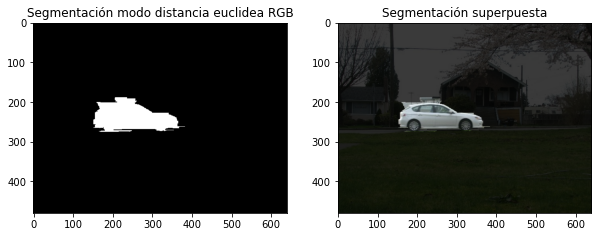

In [22]:
# Muestro la segmentación previa del usuario
plt.figure()
plt.imshow(markedCoche)
plt.title("Segmentación usuario: verde - objeto; rojo - fondo")

a,b = interactiveSegmentation(coche,markedCoche,0,1)
a,b = interactiveSegmentation(coche,markedCoche,1,1)
a,b = interactiveSegmentation(coche,markedCoche,2,1)
a,b = interactiveSegmentation(coche,markedCoche,3,1)

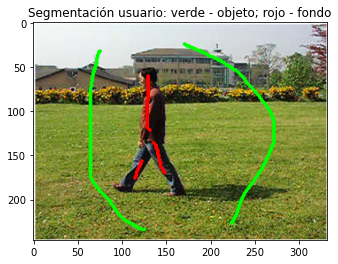

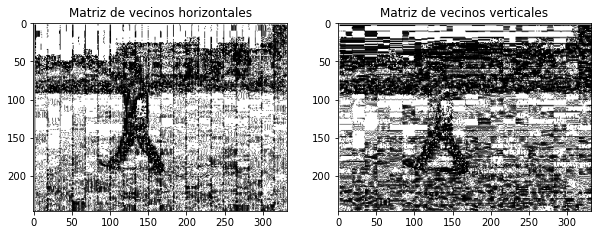

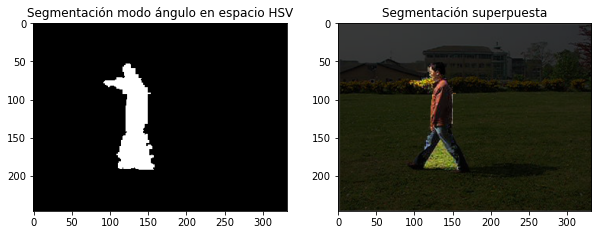

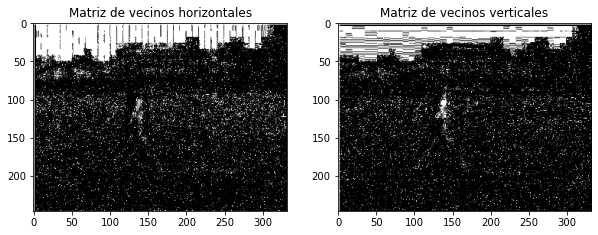

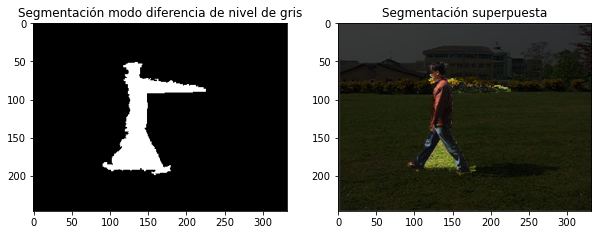

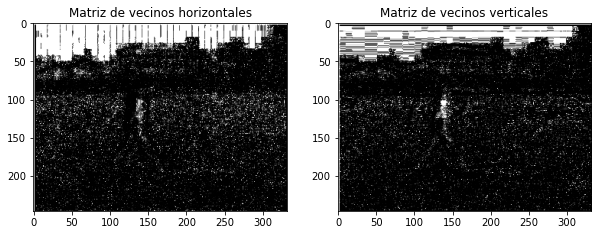

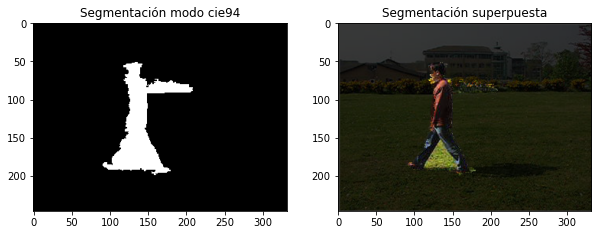

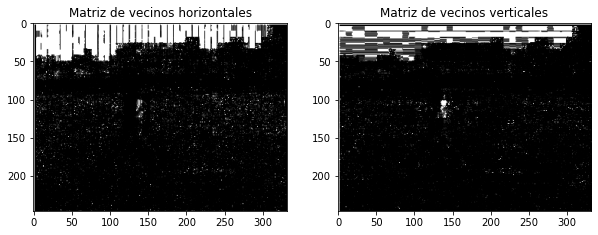

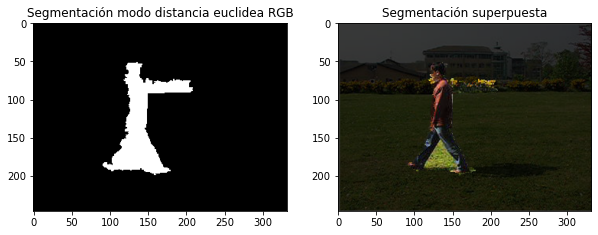

In [23]:
# Muestro la segmentación previa del usuario
plt.figure()
plt.imshow(markedPersona)
plt.title("Segmentación usuario: verde - objeto; rojo - fondo")

a,b = interactiveSegmentation(persona,markedPersona,0,1)
a,b = interactiveSegmentation(persona,markedPersona,1,1)
a,b = interactiveSegmentation(persona,markedPersona,2,1)
a,b = interactiveSegmentation(persona,markedPersona,3,1)

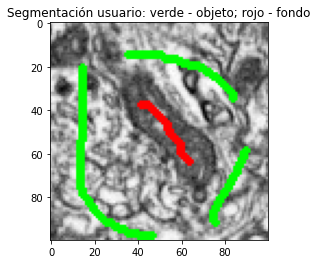

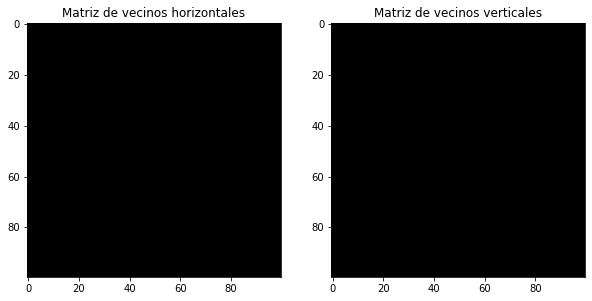

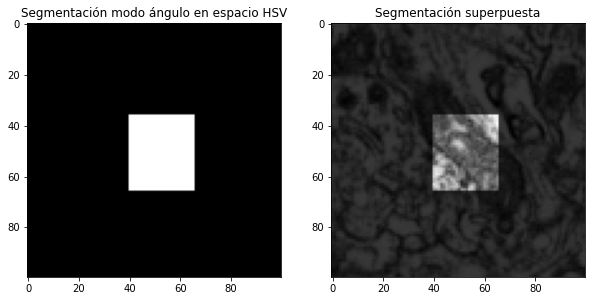

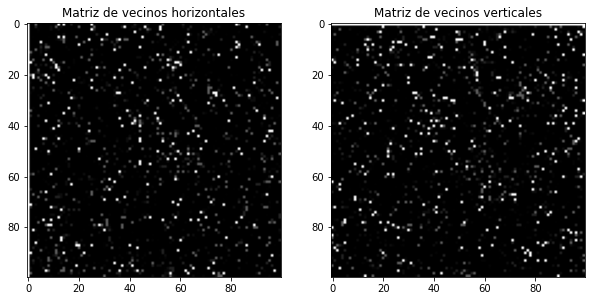

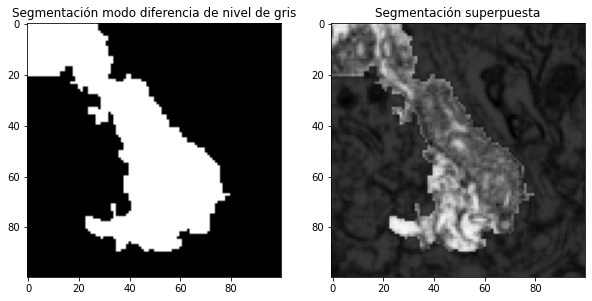

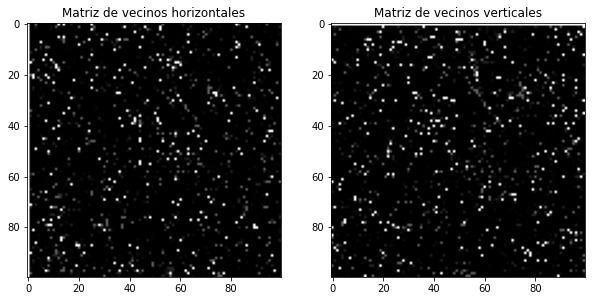

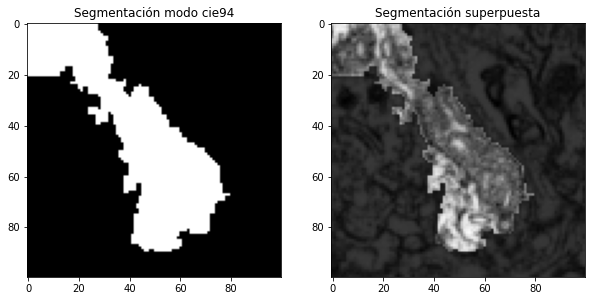

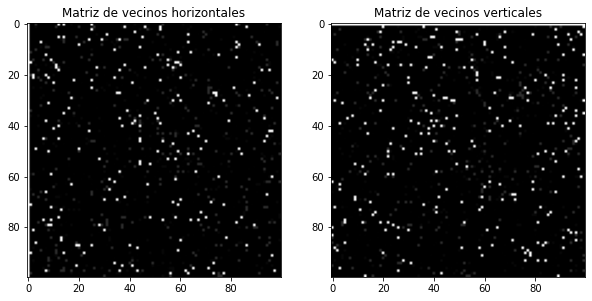

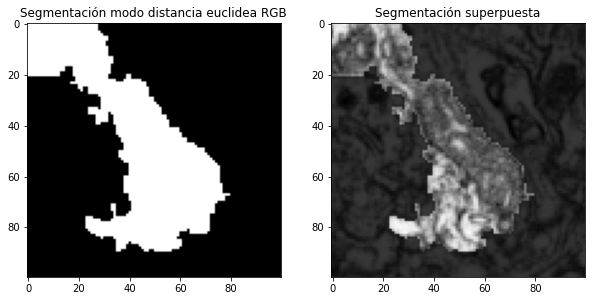

In [24]:
# Muestro la segmentación previa del usuario
plt.figure()
plt.imshow(markedMit2)
plt.title("Segmentación usuario: verde - objeto; rojo - fondo")

a,b = interactiveSegmentation(mit2,markedMit2,0,1)
a,b = interactiveSegmentation(mit2,markedMit2,1,1)
a,b = interactiveSegmentation(mit2,markedMit2,2,1)
a,b = interactiveSegmentation(mit2,markedMit2,3,1)

Revisando los resultados queda claro que, dependiendo de la imagen y de la complejidad de la imagen sobra la que se quiera hacer la segmentación, los diferentes métodos para determinar los costes de los enlaces entre pixeles vecinos tienen distinta eficacia. Por poner un ejemplo, en el caso de la imagen del caballo, que puede decirse que es sencilla porque tiene unas regiones de colores bastante bien definidas y diferenciadas entre el animal, el cielo y el suelo, funcionan bien los métodos 1, 2 y 3. Sin embargo, para el caso de la flor, que es más complicada porque contiene por un lado más bordes, y por otro una distribución de colores tanto del objeto como del fondo menos homogénea, funcionan mejor el método 0 y el 3. Para el caso del coche, que también parece una imagen más complicada que el caballo, aunque no sabríamos decir si lo es también respecto a la de la flor, el que mejor funciona es el 0, aunque en este caso los 4 métodos dan resultados razonablemente buenos.

En este sentido, no tenemos mucha información para determinar los motivos de estos funcionamientos dispares, pero sí sabemos que los cálculos de la afinidad son diferentes en cada método. Con esto en cuenta, podríamos suponer que dependiendo de las imágenes y sus propiedades, tales como la cantidad de regiones con distintos colores, la homogeneidad o dsitribución de los mismos, y otras características, unos métodos u otros se adecúan más. Es decir, que dependiendo de la imagen, puede interesar utilizar uno u otro.

Aparte de esto, y a modo de comparativa con lo que se ha explicado en el artículo sobre corte interactivo de grafos visto en clase, se puede comentar que la segmentación, aunque pueda llegar a ser relativamente buena en algunas de las imágenes, no tiene en cuenta en su estructura de costes de enlaces de manera explícita propiedades de las regiones de la imagen. Solo cuenta con un término unitario que puede entenderse como las propiedades de bordes de la misma, y eso desemboca en unos resultados que, cuando los bordes no son lo suficientemente "buenos" o "adecuados" para la segmentación, ésta no es capaz de localizar el objeto correctamente. Además, tampoco cuenta con una estructura de costes entre nodos terminales y pixeles que no sean semillas, es deicr, no marcados por el usuario, lo cual si atendemos al artículo también disminuye la capacidad de segmentación del algoritmo.

## **Ejercicio 7.** 
Mejora el algoritmo anterior. Sugerencia:
* Refina la segmentación iterativamente,
* Mejora la función de afinidad entre píxeles,
* Mejora los términos unitarios, ...

Aplica el algoritmo a las imágenes utilizadas en el ejercicio anterior. Muestra y discute los resultados. Jusfifica en qué y por qué mejoran los resultados y plantea posibles soluciones para los fallos.

(180, 272, 3)
(246, 332, 3)
(480, 640, 3)
(100, 100, 3)
Rojo - objeto
Verde - fondo


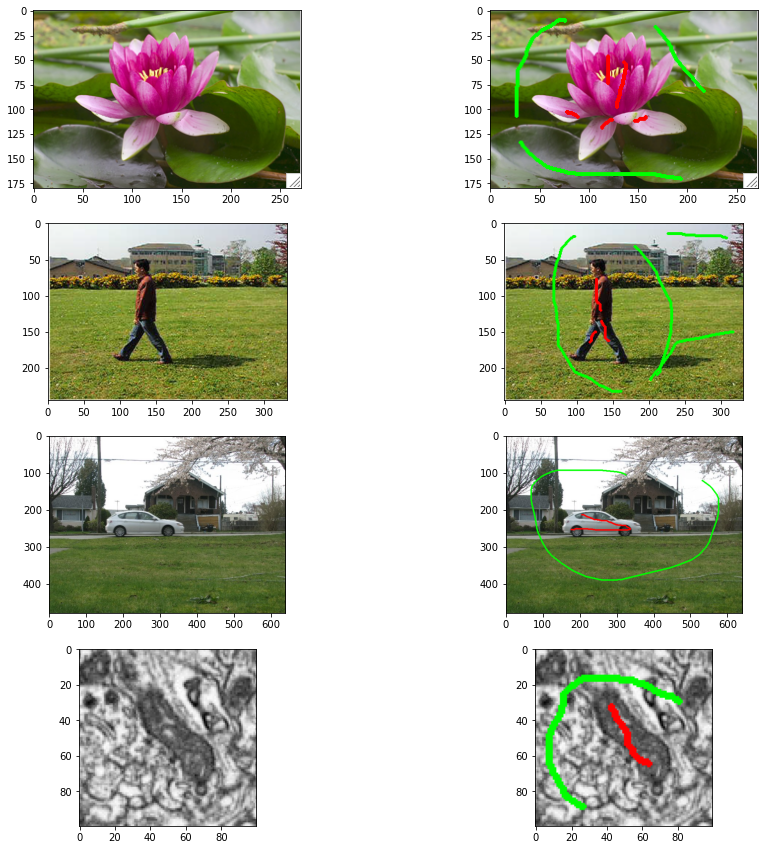

In [25]:
import pygame
import numpy as np
import cv2
import maxflow
import matplotlib.pyplot as plt
import os

from skimage.restoration import estimate_sigma

from math import sqrt
from scipy import signal
from scipy import stats

flor = "imagenes/flower.png"
persona = "imagenes/persona.png"
coche = "imagenes/car.jpg"
mit2 = "imagenes/mit2.png"

flor = cv2.cvtColor(cv2.imread(flor), cv2.COLOR_BGR2RGB)
persona = cv2.cvtColor(cv2.imread(persona), cv2.COLOR_BGR2RGB)
coche = cv2.cvtColor(cv2.imread(coche), cv2.COLOR_BGR2RGB)
mit2 = cv2.cvtColor(cv2.imread(mit2), cv2.COLOR_BGR2RGB)

f, axs = plt.subplots(4, 2, figsize=(15,15))
axs[0,0].imshow(flor)
axs[1,0].imshow(persona)
axs[2,0].imshow(coche)
axs[3,0].imshow(mit2)

print(flor.shape)
print(persona.shape)
print(coche.shape)
print(mit2.shape)

# Marco algunos pixeles que pertenecen el objeto y el fondo
markedFlor = select_fg_bg(flor)
markedPersona = select_fg_bg(persona)
markedCoche = select_fg_bg(coche)
markedMit2 = select_fg_bg(mit2)
print("Rojo - objeto")
print("Verde - fondo")

axs[0,1].imshow(markedFlor)
axs[1,1].imshow(markedPersona)
axs[2,1].imshow(markedCoche)
axs[3,1].imshow(markedMit2)

### Mejoras a la función de segmentación interactiva

* Aumentar la cantidad de vecinos para tener en cuenta los vecinos diagonales a distancia 1.
 * Al aumentar los vecinos, le damos al algoritmos de max-flow más posibilidades por donde realizar los cortes, lo que debe de mejorar los cortes potenciales. Por sí solo, este cambio no produce mejoras significativas.

In [43]:
# Establecemos la segmentación como una función que aplica la segmentación a una imagen img 
# dada una imagen marcada por el usuario markedImg y con un cálculo de la afinidad entre
# vecinos mediante la distancia entre pixeles según un modo:
# ndmode = 0 -> costes mediante diferencia en el ángulo en el espacio HSV
# ndmode = 1 -> costes mediante diferencia en el nivel de gris
# ndmode = 2 -> costes mediante el método cie94 en el espacio LAB
# ndmode = 3 -> costes mediante distancia euclidea entre tripleta RGB (u otro espacio de colores con 3 dimensiones)
# verbose = 1 -> imprimir las imágenes de la segmentación y las matrices de vecinos

# Mejoras:
# --> Rango de vecindad: en lugar de 4 pixeles vecinos por pixel, vamos a establecer un sistema de 8 vecinos que 
#     incluye diagonales

def interactiveSegmentationImproved(img,markedImg,ndmode,verbose, neighbors):
# Create the graph.
    g = maxflow.Graph[float]()

    # Add the nodes. nodeids has the identifiers of the nodes in the grid.
    nodeids = g.add_grid_nodes(img.shape[:2])

    ################################################################################################################
    exp_aff_h=np.zeros(img.shape[:2])
    exp_aff_v=np.zeros(img.shape[:2])
    exp_aff_d1=np.zeros(img.shape[:2])
    exp_aff_d2=np.zeros(img.shape[:2])
    modo = ''
    
    if ndmode==0:
        exp_aff_h, exp_aff_v, exp_aff_d1, exp_aff_d2 = hueHSVNeighbDistance8N(img)
        modo = "ángulo en espacio HSV"
    elif ndmode==1:
        exp_aff_h, exp_aff_v, exp_aff_d1, exp_aff_d2 = grayNeighbDistance8N(img)
        modo = "diferencia de nivel de gris"
    elif ndmode==2:
        exp_aff_h, exp_aff_v, exp_aff_d1, exp_aff_d2 = cie94NeighbDistance8N(img)
        modo = "método cie94 en espacio LAB"
    elif ndmode==3:
        exp_aff_h, exp_aff_v, exp_aff_d1, exp_aff_d2 = euclideanNeighbTripletDistance8N(img)
        modo = "distancia euclidea RGB"
    elif ndmode==4:
        exp_aff_h = neighbors[0]
        exp_aff_v = neighbors[0]
        exp_aff_d1 = neighbors[0]
        exp_aff_d2 = neighbors[0]
        modo = "iterativo"

    ################################################################################################################

    # Construyo el grafo 
    # Para construir el grafo relleno las estructuras
    hor_struc=np.array([[0, 0, 0],
                        [1, 0, 0],
                        [0, 0, 0]])

    ver_struc=np.array([[0, 1, 0],
                        [0, 0, 0],
                        [0, 0, 0]])
    
    d1_struc =np.array([[1, 0, 0],
                        [0, 0, 0],
                        [0, 0, 0]])
        
    d2_struc =np.array([[0, 0, 1],
                        [0, 0, 0],
                        [0, 0, 0]])
    
    # Construyo el grafo 
    g.add_grid_edges(nodeids, exp_aff_h, hor_struc,symmetric=True)
    g.add_grid_edges(nodeids, exp_aff_v, ver_struc,symmetric=True)
    g.add_grid_edges(nodeids, exp_aff_d1, d1_struc,symmetric=True)
    g.add_grid_edges(nodeids, exp_aff_d2, d2_struc,symmetric=True)

    # Leo los pixeles etiquetados
    # Los marcados en rojo representan el objeto
    pts_fg = np.transpose(np.where(np.all(np.equal(markedImg,(255,0,0)),2)))
    # Los marcados en verde representan el fondo
    pts_bg = np.transpose(np.where(np.all(np.equal(markedImg,(0,255,0)),2)))
    
    ################################################################################################################
    
    K = 10000000
    # Incluyo las conexiones a los nodos terminales
    # Pesos de los nodos terminales
    g.add_grid_tedges(nodeids[pts_fg[:,0],pts_fg[:,1]], K, 0)
    g.add_grid_tedges(nodeids[pts_bg[:,0],pts_bg[:,1]], 0, K) 
    
    pts_xy, pObj, pBkc = tLinks(img,markedImg,pts_fg,pts_bg)
    #g.add_grid_tedges(nodeids[pts_xy[:,0],pts_xy[:,1]], pBkc, pObj)
    
    ################################################################################################################


    # Find the maximum flow.
    g.maxflow()
    # Get the segments of the nodes in the grid.
    sgm = g.get_grid_segments(nodeids)
    
    segm = np.uint8(np.logical_not(sgm))
    
    # Lo muestro junto con la imagen para ver el resultado
    wgs=(np.float_(np.logical_not(sgm))+0.3)/1.3
    # Replico los pesos para cada canal y ordeno los indices
    wgs=np.rollaxis(np.tile(wgs,(3,1,1)),0,3)
    segmSuperp = np.uint8(np.multiply(img,wgs))

    if (verbose==1):
        # Muestro las matrices de pesos h y v
        f, axs = plt.subplots(1, 2, figsize=(10,10))
        axs[0].set_title('Matriz de vecinos horizontales')
        axs[0].imshow(exp_aff_h,cmap='gray')
        axs[1].set_title('Matriz de vecinos verticales')
        axs[1].imshow(exp_aff_v,cmap='gray')

        # Muestro el resultado de la segmentacion
        f, axs = plt.subplots(1, 2, figsize=(10,10))
        axs[0].set_title('Segmentación modo {}'.format(modo))
        axs[0].imshow(segm,cmap='gray')
        
        axs[1].set_title('Segmentación superpuesta')
        axs[1].imshow(segmSuperp)
    
    neighbors = [0,0,0,0]
    neighbors[0] = exp_aff_h
    neighbors[1] = exp_aff_v
    neighbors[2] = exp_aff_d1
    neighbors[3] = exp_aff_d2
    
    return segm, segmSuperp, neighbors

### Mejoras en el cálculo de las matrices de pesos
* Además de utilizar un sistema de 8 vecinos, se puede utilizar la formulación presente en el artículo *Interactive Graph Cuts for Optimal Boundary & Region Segmentation of Objects in N-D Images* que se ha presentado en clase. 
 * El término de afinidad entre un par de píxeles $p$ y $q$ se calcula como la exponencial de menos la diferencia entre píxeles al cuadrado partido por dos veces la varianza al cuadrado. La parte de la distancia entre vecinos se puede obviar en este caso porque solo se consideran vecinos los 8 adyacentes (distancia = 1):
      * $ exp ( \frac{(I_{p} - I_{q})^2}{2\sigma^2} ) $
* Para ello, es necesario estimar un parámetro, $\sigma$, que hace referencia al ruido estimado de la imagen. Para hacer esto, hemos encontrado dos maneras. 
 * La primera es una función encontrada en https://stackoverflow.com/questions/2440504/noise-estimation-noise-measurement-in-image que dice estar basada en el artículo:
     * J. Immerkær, *“Fast Noise Variance Estimation”*, Computer Vision and Image Understanding, Vol. 64, No. 2, pp. 300-302, Sep. 1996
 * La segunda, es una función presente en la librería scikit-image, llamada estimate_sigma. Esta función queda descrita en su especificación como "Estimador robusto basado en ondículas de la desviación estándar del ruido (gaussiano)".

Haciendo una comprobación sobre las 4 imágenes los resultados son considerablemente diferentes. Como no nos hemos parado a comprobar la veracidad y calidad de la primera función, hemos decidido confiar en scikit-image y la función que nos proporciona.

In [38]:
def estimate_noise(img):
    I = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    H, W = I.shape

    M = [[1, -2, 1],
       [-2, 4, -2],
       [1, -2, 1]]

    sigma = np.sum(np.sum(np.absolute(signal.convolve2d(I, M) ) ) )
    sigma = sigma * sqrt(0.5 * np.pi) / (6 * (W-2) * (H-2))

    return sigma

I = mit2
a = estimate_noise(I)
b = estimate_sigma(I, multichannel=True, average_sigmas=True)
print("mit2:\t\t", a, " \t-- ",b)

I = flor
a = estimate_noise(I)
b = estimate_sigma(I, multichannel=True, average_sigmas=True)
print("flor:\t\t", a, " \t-- ",b)

I = persona
a = estimate_noise(I)
b = estimate_sigma(I, multichannel=True, average_sigmas=True)
print("persona:\t", a, " \t-- ",b)

I = coche
a = estimate_noise(I)
b = estimate_sigma(I, multichannel=True, average_sigmas=True)
print("coche:\t\t", a, " \t-- ",b)

mit2:		 9.219027664295636  	--  10.001389751942204
flor:		 2.0765132551111574  	--  1.1966351150239787
persona:	 5.237852767079989  	--  4.140177893517097
coche:		 6.873849094380783  	--  3.214522432805367


In [39]:
## Calculo de afinidad entre pixeles mediante diferencia de ángulo en el espacio HSV
# Nota: parece que tiene cierta utilidad para encontrar bordes de la imagen
def hueHSVNeighbDistance8N(img):
    # Calcula los costes de los nodos no terminales del grafo
    # En esta versión, se calcula como la diferencia entre valores de pixeles vecinos
    # Para ello, una forma que hemos visto como recomendada por el foro de OpenCV
    # consiste en utilizar la rueda HSV (hue, saturation, value) como representación
    # de los colores, y coger el ángulo (hue) en la rueda de colores para calcular las 
    # diferencias entre pixeles vecinos. 

    # Se ha escogido este método después de buscar formas de hacerlo, y de ver que en ese 
    # foro se comenta que funciona bastante bien para segmentación. Existen estándares 
    # como CIE94 o CIELAB, pero para segmentación de objetos comentan que no es necesario

    # Nota: es el que peor resultados termina dado al aplicar la exponencial a las matrices de pesos

    # Cambiamos el espacio de colores a HSV y extraemos dos dimensiones de la resolución 
    # de la imagen
    imgHSV = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    rows = img.shape[0]
    cols = img.shape[1]

    # Nos quedamos con la primera componente de cada pixel, el ángulo en la ruleta de colores.
    # Hacemos un casting a float porque sino, al calcular diferencias entre angulos puede
    # haber desbordamiento
    h_values = imgHSV[:,:,0].astype(np.float)

    # Estos son los costes de los vecinos horizontales
    exp_aff_h=np.zeros(img.shape[:2])
    # En este espacio de color, el ángulo varía entre 0 y 180º en lugar de llegar a 360º
    # Hay que corregir los valores si cruzan los 0º
    # Entre 10º y 170º hay 160 de diferencia, pero al ser 180 equivalente a 0º, deben ser 20º
    for x in range(0,exp_aff_h.shape[0]):
        for y in range(1,exp_aff_h.shape[1]):
            exp_aff_h[x,y] = abs(h_values[x,y] - h_values[x,y-1])
            exp_aff_h[x,y] = min( exp_aff_h[x,y], 180 - exp_aff_h[x,y] )

    # Estos son los costes de los vecinos verticales
    # Adaptamos el método usado para los horizontales
    exp_aff_v=np.zeros(img.shape[:2])
    for x in range(1,exp_aff_v.shape[0]):
        for y in range(0,exp_aff_v.shape[1]):
            exp_aff_v[x,y] = abs(h_values[x,y] - h_values[x-1,y])
            exp_aff_v[x,y] = min( exp_aff_v[x,y], 180 - exp_aff_v[x,y] )
            
    # Estos son los costes de los vecinos superiores diagonales por la izquierda
    exp_aff_d1=np.zeros(img.shape[:2])
    for x in range(1,exp_aff_v.shape[0]):
        for y in range(1,exp_aff_v.shape[1]):
            exp_aff_d1[x,y] = abs(h_values[x,y]-h_values[x-1,y-1])
            exp_aff_d1[x,y] = min( exp_aff_d1[x,y], 180 - exp_aff_d1[x,y] )
            
    # Estos son los costes de los vecinos superiores diagonales por la derecha
    exp_aff_d2=np.zeros(img.shape[:2])
    for x in range(1,exp_aff_v.shape[0]):
        for y in range(0,exp_aff_v.shape[1]-1):
            exp_aff_d2[x,y] = abs(h_values[x,y] - h_values[x-1,y+1])
            exp_aff_d2[x,y] = min( exp_aff_d2[x,y], 180 - exp_aff_d2[x,y] )

    # Estimamos un valor sigma de ruido gaussiano de la imagen
    sigma = estimate_sigma(I, multichannel=True, average_sigmas=True)
    # Aplicamos exponencia a la matriz cambiada de signo, de forma que se acentue la diferencia
    # entre regiones de la imagen    
    exp_aff_h = np.exp(-(exp_aff_h)**2 / (2*sigma**2))
    exp_aff_v = np.exp(-(exp_aff_v)**2 / (2*sigma**2))
    exp_aff_d1 = np.exp(-(exp_aff_d1)**2 / (2*sigma**2))
    exp_aff_d2 = np.exp(-(exp_aff_d2)**2 / (2*sigma**2))
    
    return exp_aff_h, exp_aff_v, exp_aff_d1, exp_aff_d2


## Calculo de afinidad entre pixeles mediante diferencia en el nivel de gris (luminancia)
def grayNeighbDistance8N(img):
    # Para ello, cambiamos al espacio de color de escala de grises, y las diferencias podrán 
    # obtenerse directamente restando los valores de los vecinos
    imgGray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # Hacemos un casting a float porque sino, al calcular diferencias entre escala de grises
    # puede haber desbordamiento
    g_values = imgGray[:,:].astype(np.float)

    # Estos son los costes de los vecinos horizontales
    exp_aff_h=np.zeros(img.shape[:2])
    for x in range(0,exp_aff_h.shape[0]):
        for y in range(1,exp_aff_h.shape[1]):
            exp_aff_h[x,y] = abs(g_values[x,y]-g_values[x,y-1])

    # Estos son los costes de los vecinos verticales
    exp_aff_v=np.zeros(img.shape[:2])
    for x in range(1,exp_aff_v.shape[0]):
        for y in range(0,exp_aff_v.shape[1]):
            exp_aff_v[x,y] = abs(g_values[x,y]-g_values[x-1,y])
            
    # Estos son los costes de los vecinos superiores diagonales por la izquierda
    exp_aff_d1=np.zeros(img.shape[:2])
    for x in range(1,exp_aff_v.shape[0]):
        for y in range(1,exp_aff_v.shape[1]):
            exp_aff_d1[x,y] = abs(g_values[x,y]-g_values[x-1,y-1])
            
    # Estos son los costes de los vecinos superiores diagonales por la derecha
    exp_aff_d2=np.zeros(img.shape[:2])
    for x in range(1,exp_aff_v.shape[0]):
        for y in range(0,exp_aff_v.shape[1]-1):
            exp_aff_d2[x,y] = abs(g_values[x,y]-g_values[x-1,y+1])

    # Estimamos un valor sigma de ruido gaussiano de la imagen
    sigma = estimate_sigma(I, multichannel=True, average_sigmas=True)
    # Aplicamos exponencia a la matriz cambiada de signo, de forma que se acentue la diferencia
    # entre regiones de la imagen    
    exp_aff_h = np.exp(-(exp_aff_h)**2 / (2*sigma**2))
    exp_aff_v = np.exp(-(exp_aff_v)**2 / (2*sigma**2))
    exp_aff_d1 = np.exp(-(exp_aff_d1)**2 / (2*sigma**2))
    exp_aff_d2 = np.exp(-(exp_aff_d2)**2 / (2*sigma**2))
    
    return exp_aff_h, exp_aff_v, exp_aff_d1, exp_aff_d2


## Calculo afinidad mediante la diferencia entre dos colores RGB con cie94 
def cie94NeighbDistance8N(img):
    imgLab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    # Hacemos un casting a float para evitar desbordamiento
    l_values = imgLab[:,:,:].astype(np.float)

    # Estos son los costes de los vecinos horizontales
    exp_aff_h=np.zeros(img.shape[:2])
    for x in range(0,exp_aff_h.shape[0]):
        for y in range(1,exp_aff_h.shape[1]):
            exp_aff_h[x,y] = cie94(l_values[x,y],l_values[x,y-1])

    # Estos son los costes de los vecinos verticales
    exp_aff_v=np.zeros(img.shape[:2])
    for x in range(1,exp_aff_v.shape[0]):
        for y in range(0,exp_aff_v.shape[1]):
            exp_aff_v[x,y] = cie94(l_values[x,y],l_values[x-1,y])
            
    # Estos son los costes de los vecinos superiores diagonales por la izquierda
    exp_aff_d1=np.zeros(img.shape[:2])
    for x in range(1,exp_aff_v.shape[0]):
        for y in range(1,exp_aff_v.shape[1]):
            exp_aff_d1[x,y] = cie94(l_values[x,y], l_values[x-1,y-1])
            
    # Estos son los costes de los vecinos superiores diagonales por la derecha
    exp_aff_d2=np.zeros(img.shape[:2])
    for x in range(1,exp_aff_v.shape[0]):
        for y in range(0,exp_aff_v.shape[1]-1):
            exp_aff_d2[x,y] = cie94(l_values[x,y], l_values[x-1,y+1])

    # Estimamos un valor sigma de ruido gaussiano de la imagen
    sigma = estimate_sigma(I, multichannel=True, average_sigmas=True)
    # Aplicamos exponencia a la matriz cambiada de signo, de forma que se acentue la diferencia
    # entre regiones de la imagen    
    exp_aff_h = np.exp(-(exp_aff_h)**2 / (2*sigma**2))
    exp_aff_v = np.exp(-(exp_aff_v)**2 / (2*sigma**2))
    exp_aff_d1 = np.exp(-(exp_aff_d1)**2 / (2*sigma**2))
    exp_aff_d2 = np.exp(-(exp_aff_d2)**2 / (2*sigma**2))
    
    return exp_aff_h, exp_aff_v, exp_aff_d1, exp_aff_d2


def euclideanNeighbTripletDistance8N(img):
    # Dado que en el caso de los anteriores los resultados han sido realmente malos, 
    # vamos a hacer un último intento con este otro tipo de medida para la distancia

    # Hacemos un casting a int16 para evitar desbordamiento
    rgb_values = img[:,:,:].astype(np.int16)

    # Estos son los costes de los vecinos horizontales
    exp_aff_h=np.zeros(img.shape[:2])
    for x in range(0,exp_aff_h.shape[0]):
        for y in range(1,exp_aff_h.shape[1]):
            exp_aff_h[x,y] = eucDist(rgb_values[x,y], rgb_values[x,y-1])

    # Estos son los costes de los vecinos verticales
    exp_aff_v=np.zeros(img.shape[:2])
    for x in range(1,exp_aff_v.shape[0]):
        for y in range(0,exp_aff_v.shape[1]):
            exp_aff_v[x,y] = eucDist(rgb_values[x,y], rgb_values[x-1,y])
            
    # Estos son los costes de los vecinos superiores diagonales por la izquierda
    exp_aff_d1=np.zeros(img.shape[:2])
    for x in range(1,exp_aff_v.shape[0]):
        for y in range(1,exp_aff_v.shape[1]):
            exp_aff_d1[x,y] = eucDist(rgb_values[x,y], rgb_values[x-1,y-1])
            
    # Estos son los costes de los vecinos superiores diagonales por la derecha
    exp_aff_d2=np.zeros(img.shape[:2])
    for x in range(1,exp_aff_v.shape[0]):
        for y in range(0,exp_aff_v.shape[1]-1):
            exp_aff_d2[x,y] = eucDist(rgb_values[x,y], rgb_values[x-1,y+1])

    # Estimamos un valor sigma de ruido gaussiano de la imagen
    sigma = estimate_sigma(I, multichannel=True, average_sigmas=True)
    # Aplicamos exponencia a la matriz cambiada de signo, de forma que se acentue la diferencia
    # entre regiones de la imagen    
    exp_aff_h = np.exp(-(exp_aff_h)**2 / (2*sigma**2))
    exp_aff_v = np.exp(-(exp_aff_v)**2 / (2*sigma**2))
    exp_aff_d1 = np.exp(-(exp_aff_d1)**2 / (2*sigma**2))
    exp_aff_d2 = np.exp(-(exp_aff_d2)**2 / (2*sigma**2))
    
    return exp_aff_h, exp_aff_v, exp_aff_d1, exp_aff_d2

NameError: name 'pts_x' is not defined

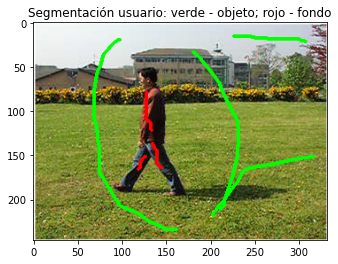

In [44]:
# Muestro la segmentación previa del usuario

markedPersona2 = markedPersona[:,:,:]

plt.figure()
plt.imshow(markedPersona)
plt.title("Segmentación usuario: verde - objeto; rojo - fondo")

a,b,c = interactiveSegmentationImproved(persona,markedPersona,0,1,0)
a,b,c = interactiveSegmentationImproved(persona,markedPersona,1,1,0)
a,b,c = interactiveSegmentationImproved(persona,markedPersona,2,1,0)
a,b,c = interactiveSegmentationImproved(persona,markedPersona,3,1,0)

### Mejora de funcion de manera iterativa

Igual que en el Ejercicio 6, le mostramos al usuario la imagen que deseamos segmentar para que elija que pixeles perteneces al objeto y cuales al fondo.

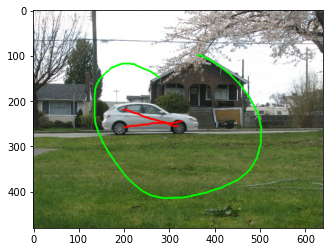

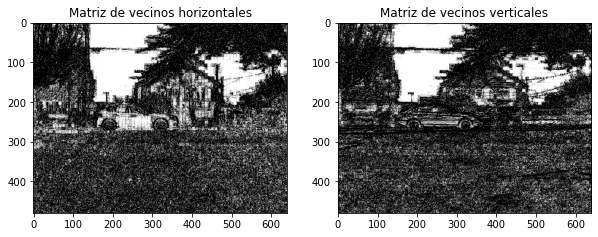

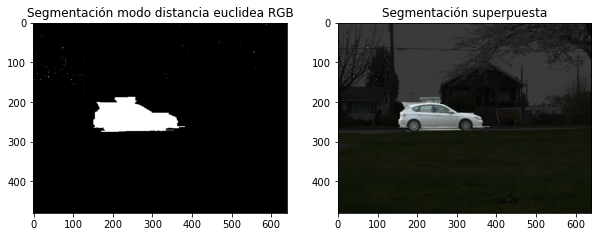

In [30]:
imagen = "imagenes/car.jpg"
imgBGR = cv2.imread(imagen)
img = cv2.cvtColor(cv2.imread(imagen), cv2.COLOR_BGR2RGB)
markedImg = select_fg_bg(img)
plt.imshow(markedImg)
segm, segmSuperp, neighbors = interactiveSegmentationImproved(img,markedImg,3,1,0)
plt.show()

Es importante guardar el peso de los n-links es decir de los links entre vecinos, para no volver a calcularlos en futuras iteraciones. Esto hara que tanto el tiempo como los recursos de computo sean mucho menores. 
Para la llamada iterativa, le pasamos la siguiente infromacion:
ultima segmentacion que hemos obtenido asi como el conjuntos de pixeles totales 

1.   La imagen original que estamos segmentando.
2.   La imagen con el total de los puntos pintados por el usuario que indican que es objeto y que es fondo.
3.   La segmentacion que hemos obtenido con la imagen con el total de los puntos pintados.
4.   El peso de los n-links obtenido en la anterior iteracion.

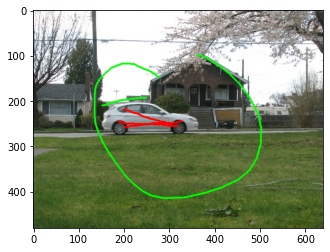

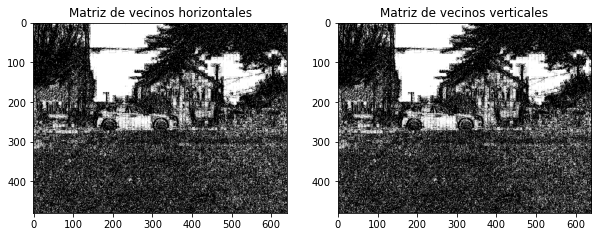

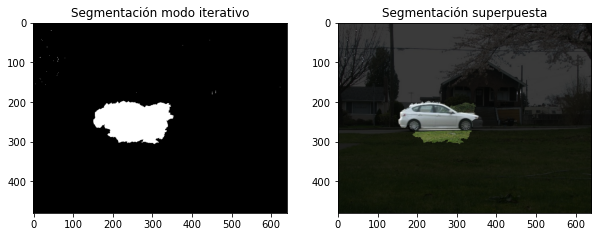

In [31]:
def iterativeInteractiveSegmentation(img, markedImgAcumulated, segmSuperp, neighbors):
    markedImgNewDots = select_fg_bg(segmSuperp)
    
    pts_fg = np.transpose(np.where(np.all(np.equal(markedImgNewDots,(255,0,0)),2)))
    # Los marcados en verde representan el fondo
    pts_bg = np.transpose(np.where(np.all(np.equal(markedImgNewDots,(0,255,0)),2)))
    
    for a in pts_fg:
        markedImgAcumulated[a[0]][a[1]]  = [255,0,0]
        
    for b in pts_bg:
        markedImgAcumulated[b[0]][b[1]]  = [0,255,0]
        
    plt.imshow(markedImgAcumulated)
        
    segm, segmSuperp, neighbors = interactiveSegmentationImproved(img,markedImgAcumulated,4,1,neighbors)
    return segmSuperp, markedImgAcumulated, neighbors

segmSuperp, markedImgAcumulated, neighbors = iterativeInteractiveSegmentation(img,markedImg,segmSuperp, neighbors)

A la hora de ejecutar las siguientes iteraciones, es notable como el tiempo de computo hasta obtener el resultados es mucho menor. Pasa de ser de varios segundos a ser instantaneo.

### Mejora de los términos unitarios
Función para determinar la probabilidad de asignar a cada pixel de los no marcados la etiqueta de objeto o de fondo.
Hemos tratado de hacerla funcionar hasta el último momento, pero no nos ha sido posible al final. 

La idea es utilizar los pixeles establecidos por el usuario como objeto y fondo para estimar distribuciones gaussianas.
Para ello, hemos pasado la imagen a la escala de grises, de forma que se pueda calcular de manera sencilla con una distribución normal con media y desviación típica la de los pixeles marcados como objeto por un lado y como fondo por el otro. Luego, le pasamos el conjunto de pixeles no etiquetado a cada una de estas distribuciones para obtener la probabilidad de que a cada uno de esos pixeles no etiquetados sean objeto y sean fondo. Con el menos logaritmo neperiano montamos los costes asociados a dichas probabilidades para que cuadren con los costes de los t-links, y así alimentamos el algoritmo de segmentación interactiva añadiendo dos enlaces t-link a cada pixel sin marcar por el usuario con dichas probabilidad. De esta forma, se pueden añadir los términos que hacen referencia a las propiedades de las regiones de la imagen, tal y como se explica en el artículo de corte interactivo de grafos que se ha visto en clase.

Nos ha acabado fallando al añadir los enlaces t-links al grafo en la función de segmentación interactiva, no tenemos muy claro el por qué ya que sigue el mismo esquema que se sigue al añadir los pesos los pixeles marcados.

In [42]:
def tLinks(img,markedImg,pts_fg,pts_bg):
    pts_xy = np.empty((1,2), dtype=np.uint8)

    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    obj_markedGray = np.empty((1,1), dtype=np.uint8)
    bck_markedGray = np.empty((1,1), dtype=np.uint8)

    unmarkedPObj = np.empty((1,1), dtype=np.uint8)
    unmarkedPBck = np.empty((1,1), dtype=np.uint8)
    

    # Vamos a extraer las coordenadas de los puntos sin marcar por el usuario
    for x in range(0,markedImg.shape[0]):
        for y in range(0,markedImg.shape[1]):
            pts_xy = np.append(pts_xy, np.array([x,y]).reshape(1,2), axis=0)
    pts_xy = np.delete(pts_x, 0, axis=0)

    for a in pts_bg:
        pts_xy = np.delete(pts_xy, a[0]*a[1], axis=0)
    for a in pts_fg:
        pts_xy = np.delete(pts_xy, a[0]*a[1], axis=0)


    for x,y in pts_fg:
        obj_markedGray = np.append(obj_markedGray, gray_img[x,y].reshape(1,1), axis=0)
    obj_markedGray = np.delete(obj_markedGray, 0, axis=0)

    for x,y in pts_bg:
        bck_markedGray = np.append(bck_markedGray, gray_img[x,y].reshape(1,1), axis=0)
    bck_markedGray = np.delete(bck_markedGray, 0, axis=0)

    for x,y in pts_xy:
        unmarkedPObj = np.append(unmarkedPObj, gray_img[x,y].reshape(1,1), axis=0)
        unmarkedPBck = np.append(unmarkedPBck, gray_img[x,y].reshape(1,1), axis=0)
    unmarkedPObj = np.delete(unmarkedPObj, 0, axis=0)
    unmarkedPBck = np.delete(unmarkedPBck, 0, axis=0)


    # Calculo de la media y la desviación típica para el objeto:
    objMean = np.mean(obj_markedGray)
    objStd = np.std(obj_markedGray)

    # Calculo de la media y la desviación típica para el fondo:
    bckMean = np.mean(bck_markedGray)
    bckStd = np.std(bck_markedGray)


    pObj = stats.norm.pdf(unmarkedPObj,objMean,objStd)
    pObj = -np.log(pObj)
    pBkc = stats.norm.pdf(unmarkedPBck,bckMean,bckStd)
    pBkc = -np.log(pBkc)
    
    return pts_xy, pObj, pBkc